In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import math
import random
import ast
from bs4 import BeautifulSoup
import unidecode
import re
from emot.emo_unicode import UNICODE_EMOJI, UNICODE_EMOJI_ALIAS, EMOTICONS_EMO
from flashtext import KeywordProcessor
import swifter
from tqdm import tqdm
import sys
sys.path.append('../')
from src.data.better_profanity import Profanity
from src.data.data_preprocess import tokenize_inputs,clean_data,jigsaw_unintended_data_split,merge_jigsaw_unintended_data
from src.visualization.graph_maker import show_data_distribution,show_number_of_comments_greater_and_less_than_threshold,plot_toxicity_distribution,annotator_count_heatmap,plot_toxic_label_count,annotation_distribution,annotation_toxicity_distribution,disagreement_distribution,disagreement_method_comparison
from tqdm import tqdm
import multiprocessing as mp
import os
project_path=os.path.dirname(os.path.abspath("__file__")).split("src")[0]

ModuleNotFoundError: No module named 'src'

# Merge datasets

In [2]:
df = pd.read_csv("../data/raw/jigsaw-unintended-bias-in-toxicity-classification/all_data.csv")
df_annotations=pd.read_csv("../data/raw/jigsaw-unintended-bias-in-toxicity-classification/toxicity_individual_annotations.csv")
df.drop(columns=['created_date', 'publication_id',
       'parent_id', 'article_id', 'rating', 'funny', 'wow', 'sad', 'likes',
       'disagree','male', 'female', 'transgender',
       'other_gender', 'heterosexual', 'homosexual_gay_or_lesbian', 'bisexual',
       'other_sexual_orientation', 'christian', 'jewish', 'muslim', 'hindu',
       'buddhist', 'atheist', 'other_religion', 'black', 'white', 'asian',
       'latino', 'other_race_or_ethnicity', 'physical_disability',
       'intellectual_or_learning_disability', 'psychiatric_or_mental_illness',
       'other_disability', 'identity_annotator_count','severe_toxicity', 'obscene', 'sexual_explicit',
       'identity_attack', 'insult', 'threat'],inplace=True)
df.dropna(inplace=True)
df.reset_index(drop=True, inplace=True)

In [ ]:
df["split"].value_counts()

split
train    1804871
test      194641
Name: count, dtype: int64

In [3]:
df_annotations

,id,worker,toxic,severe_toxic,identity_attack,insult,obscene,sexual_explicit,threat
0,59859,0,1,0,0,1,1,0,0
1,59859,1,1,0,0,0,1,0,0
2,59859,2,1,0,0,1,1,0,0
3,59859,3,1,1,0,0,1,0,0
4,59859,4,1,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...
15855261,6333871,3838,1,0,0,1,0,0,0
15855262,6333947,5404,0,0,0,0,0,0,0
15855263,6333947,5321,0,0,0,0,0,0,0
15855264,6333947,1072,0,0,0,0,0,0,0


In [4]:
# df_annotations.groupby('id')['toxic'].apply(list).values
df_comment_annotation=df_annotations.groupby('id')['toxic'].apply(list).reset_index(name='toxic_values')

In [5]:
df_comment_annotation

,id,toxic_values
0,59848,"[0, 0, 0, 0]"
1,59849,"[0, 0, 0, 0]"
2,59852,"[0, 0, 0, 0]"
3,59855,"[0, 0, 0, 0]"
4,59856,"[1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
...,...,...
1804869,6333967,"[0, 0, 0, 0]"
1804870,6333969,"[0, 0, 0, 0]"
1804871,6333982,"[0, 0, 0, 0]"
1804872,6334009,"[1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, ..."


In [6]:
df_final = df.merge(df_comment_annotation, on='id', how='left')


In [7]:
def generate_random_distribution(num_annotators, prop_toxicity):
    """
    Generate a list with a random distribution of 0s and 1s based on a given proportion.

    Args:
    num_annotators (int): Total number of annotators.
    prop_toxicity (float): Proportion of 1s (toxicity values).

    Returns:
    list: List with the distribution of 0s and 1s.
    """
    num_toxic = int(num_annotators * prop_toxicity)
    distribution = [1] * num_toxic + [0] * (num_annotators - num_toxic)
    random.shuffle(distribution)
    return distribution


In [8]:
df_final['toxic_values'] = df_final.apply(lambda x: generate_random_distribution(x["toxicity_annotator_count"],x["toxicity"]) if type(x["toxic_values"])==float else x["toxic_values"], axis=1)

In [9]:
df_final.dropna(inplace=True,subset=['toxic_values'])
df_final.reset_index(drop=True, inplace=True)

In [10]:
df_final

,id,comment_text,split,toxicity,toxicity_annotator_count,toxic_values
0,1083994,He got his money... now he lies in wait till a...,train,0.373134,67,"[0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, ..."
1,650904,Mad dog will surely put the liberals in mental...,train,0.605263,76,"[0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, ..."
2,5902188,And Trump continues his lifelong cowardice by ...,train,0.666667,63,"[1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, ..."
3,7084460,"""while arresting a man for resisting arrest"".\...",test,0.815789,76,"[0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, ..."
4,5410943,Tucker and Paul are both total bad ass mofo's.,train,0.550000,80,"[1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, ..."
...,...,...,...,...,...,...
1999507,1018736,Another man shamming article. If white men did...,train,0.400000,10,"[0, 1, 0, 0, 0, 1, 0, 0, 1, 1]"
1999508,340016,"""no matter what is put in front of you regardi...",train,0.400000,10,"[1, 0, 0, 1, 0, 0, 1, 1, 0, 0]"
1999509,919629,The Democrat party aided and abetted by it's M...,train,0.400000,10,"[1, 0, 1, 1, 0, 0, 0, 0, 1, 0]"
1999510,5165492,I just don't find her a very good representati...,train,0.400000,10,"[1, 0, 0, 1, 0, 1, 0, 1, 0, 0]"


In [11]:
del df_annotations
del df_comment_annotation
del df

In [12]:
df_specialized_rater= pd.read_csv("../data/raw/specialized-rater-pools-dataset/specialized_rater_pools_data.csv")
df_specialized_rater.dropna(inplace=True)

In [13]:
df_specialized_rater["toxic_score"].value_counts()

toxic_score
 1.0    246371
-1.0     76528
 0.0     33224
-2.0     24582
Name: count, dtype: int64

In this case, the annotations provide the option to mark a comment as toxic, non-toxic, or uncertain. The value 0.0 represents uncertainty, which is quite interesting. In this instance, all uncertain values will be replaced with both toxic and non-toxic values. To balance the uncertainty, for each 0.0, we will add a 1.0 (toxic) and a 0.0 (non-toxic) to the list. Since I don't have that information in the other datasets, I need to account for it as if two different viewpoints were given.

In [14]:
def get_toxicity_score(value):
    if value == 0.0:
        return [1,0]
    elif value < 0.0 :
        return 1
    elif value >0.0:
        return 0

In [15]:
df_specialized_rater["toxic_score"]= df_specialized_rater["toxic_score"].apply(lambda x: get_toxicity_score(x))

In [16]:
df_specialized_rater["toxic_score"].value_counts()

toxic_score
0         246371
1         101110
[1, 0]     33224
Name: count, dtype: int64

In [17]:
df_comment_annotation=df_specialized_rater.groupby('id')['toxic_score'].apply(list).reset_index(name='toxic_values')

In [18]:
df_comment_annotation

,id,toxic_values
0,240015,"[0, [1, 0], 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0..."
1,240038,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]"
2,240799,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]"
3,241207,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]"
4,242346,"[[1, 0], 0, [1, 0], 1, 1, 0, [1, 0], 0, 0, 0, ..."
...,...,...
25495,6333423,"[0, 0, 0, 0, [1, 0], 1, 1, 0, 0, 0, 0, [1, 0],..."
25496,6333537,"[0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]"
25497,6333639,"[0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1]"
25498,6333667,"[[1, 0], 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0..."


In [19]:
def expand_list(value_list):
    new_value_list=[]
    for value in value_list:
        if type(value)==list:
            new_value_list.extend(value)
        else:
            new_value_list.append(value)
    return new_value_list

In [20]:
df_comment_annotation["toxic_values"]=df_comment_annotation["toxic_values"].apply(lambda x: expand_list(x))

In [21]:
df_comment_annotation

,id,toxic_values
0,240015,"[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]"
1,240038,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]"
2,240799,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]"
3,241207,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]"
4,242346,"[1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, ..."
...,...,...
25495,6333423,"[0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, ..."
25496,6333537,"[0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1]"
25497,6333639,"[0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1]"
25498,6333667,"[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]"


In [22]:
merged_df = df_final.merge(df_comment_annotation, on='id', how='left')
merged_df["toxic_values_y"]= merged_df["toxic_values_y"].apply(lambda x: [] if type(x)==float else x)
merged_df["toxic_values"]= merged_df["toxic_values_x"]+merged_df["toxic_values_y"]
merged_df["toxicity_annotator_count"]=merged_df["toxic_values"].apply(lambda x: len(x))
merged_df["toxicity"]=merged_df["toxic_values"].apply(lambda x: np.mean(x))


In [25]:
filtered_df = merged_df[merged_df.apply(lambda row: len(row['toxic_values_x'])>0 and len(row['toxic_values_y'])>0, axis=1)]

In [27]:
filtered_df["toxic_values_x_mean"] = filtered_df["toxic_values_x"].apply(lambda x: np.mean(x))
filtered_df["toxic_values_y_mean"] = filtered_df["toxic_values_y"].apply(lambda x: np.mean(x))

/tmp/ipykernel_525/3267490086.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df["toxic_values_x_mean"] = filtered_df["toxic_values_x"].apply(lambda x: np.mean(x))
/tmp/ipykernel_525/3267490086.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df["toxic_values_y_mean"] = filtered_df["toxic_values_y"].apply(lambda x: np.mean(x))


In [49]:
filtered_df["toxicity_annotator_count"].value_counts().head(20)

toxicity_annotator_count
19    3233
20    3206
26    3196
21    2782
25    2413
27    2402
22    1923
28    1185
23     959
24     545
29     426
96     209
18     200
86     181
91     176
85     167
97     163
95     157
92     135
87     130
Name: count, dtype: int64

In [52]:
filtered_df["toxicity_annotator_count"].value_counts().tail(20)

toxicity_annotator_count
1152    1
1226    1
1448    1
3528    1
1390    1
1845    1
50      1
3135    1
1253    1
2299    1
1425    1
1527    1
1198    1
1221    1
1241    1
1702    1
1441    1
1708    1
3484    1
1867    1
Name: count, dtype: int64

In [54]:
filtered_df[filtered_df["toxicity_annotator_count"]<10]

,id,comment_text,split,toxicity,toxicity_annotator_count,toxic_values_x,toxic_values_y,toxic_values,toxic_values_x_mean,toxic_values_y_mean
1245741,5564669,...ready for two more ?\nFamous French singer ...,train,0.000000,9,"[0, 0, 0, 0]","[0, 0, 0, 0, 0]","[0, 0, 0, 0, 0, 0, 0, 0, 0]",0.0,0.0
1833352,5623317,I doubt that was an issue highlighted by the '...,train,0.111111,9,"[0, 1, 0, 0, 0]","[0, 0, 0, 0]","[0, 1, 0, 0, 0, 0, 0, 0, 0]",0.2,0.0


In [56]:
filtered_df["toxicity_annotator_count"].describe()

count    25500.000000
mean        35.112941
std         96.619705
min          9.000000
25%         20.000000
50%         24.000000
75%         27.000000
max       3528.000000
Name: toxicity_annotator_count, dtype: float64

In [30]:
filtered_df_flip_in_label = filtered_df[filtered_df.apply(lambda row: (row["toxic_values_x_mean"]>0.5 and row["toxic_values_y_mean"] <0.5) or (row["toxic_values_x_mean"]<0.5 and row["toxic_values_y_mean"] >0.5), axis=1)]

In [45]:
filtered_df_flip_in_label["toxicity_annotator_count"].value_counts().head(10)

toxicity_annotator_count
26    659
27    623
25    584
28    255
21    228
20    197
22    171
23    129
19    117
29     96
Name: count, dtype: int64

In [44]:
filtered_df_flip_in_label["toxicity_annotator_count"].describe()

count    4015.000000
mean       40.949689
std        71.160765
min        12.000000
25%        25.000000
50%        26.000000
75%        28.000000
max      1866.000000
Name: toxicity_annotator_count, dtype: float64

In [55]:
filtered_df_flip_in_label[filtered_df_flip_in_label["toxicity_annotator_count"]<10]

,id,comment_text,split,toxicity,toxicity_annotator_count,toxic_values_x,toxic_values_y,toxic_values,toxic_values_x_mean,toxic_values_y_mean


What we wanted to observe with this initial analysis is cases in which a label flip has occurred from one anotation scheme to the other. Specially we wanted to observe cases where with less than 10 annotators there was a change in opinion to the new dataset with more annotations. Contrary to the expected outcome, it is that for cases with more mean annotations is where we observe some kind of flip in the data. Curiously few to none data was labelled that originally had less than 10 annotators.

In [ ]:
merged_df.drop(columns=['toxic_values_x','toxic_values_y'],inplace=True)
del df_comment_annotation
del df_specialized_rater

In [ ]:
df_final=merged_df

In [ ]:
df_final.to_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_merged_data.csv",index=False)

In [ ]:
df_final

,id,comment_text,split,toxicity,toxicity_annotator_count,toxic_values
0,1083994,He got his money... now he lies in wait till a...,train,0.373134,67,"[0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, ..."
1,650904,Mad dog will surely put the liberals in mental...,train,0.605263,76,"[0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, ..."
2,5902188,And Trump continues his lifelong cowardice by ...,train,0.666667,63,"[1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, ..."
3,7084460,"""while arresting a man for resisting arrest"".\...",test,0.815789,76,"[0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, ..."
4,5410943,Tucker and Paul are both total bad ass mofo's.,train,0.550000,80,"[1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, ..."
...,...,...,...,...,...,...
1999507,1018736,Another man shamming article. If white men did...,train,0.400000,10,"[0, 1, 0, 0, 0, 1, 0, 0, 1, 1]"
1999508,340016,"""no matter what is put in front of you regardi...",train,0.230769,26,"[1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, ..."
1999509,919629,The Democrat party aided and abetted by it's M...,train,0.400000,10,"[1, 0, 1, 1, 0, 0, 0, 0, 1, 0]"
1999510,5165492,I just don't find her a very good representati...,train,0.400000,10,"[1, 0, 0, 1, 0, 1, 0, 1, 0, 0]"


## Complete Merge datasets

In [2]:
df_final=merge_jigsaw_unintended_data()

# Preprocessing

In this section we are focus in generating a set of methods to clean an normalize the data.

## Data preprocessing

In [ ]:
def removeHTMLTags(text):
    '''
    Function to remove the HTML Tags from a given text.
    
    Parameter:
    ---------
    text: str
        Text from which the HTML tags has to be removed.
    '''
    
    # Reference: 'Remove html tags using BeautifulSoup' - https://www.geeksforgeeks.org/remove-all-style-scripts-and-html-tags-using-beautifulsoup/
    
    # Create a BeautifulSoup object to parse the given html text content
    soup = BeautifulSoup(text, 'html.parser')
    
    # Remove the <style> and <script> tags from the html content because they contains the styling sheet and javascript
    # file references and won't give any meaningful context.
    for data in soup(['style', 'script']):
        
        # Remove tag
        data.decompose()
        
    # Return the html tag free content
    return ' '.join(soup.stripped_strings)

In [ ]:
def removeAccentedChars(text):
    '''
    Function to remove the accented characters from a given text.
    
    Parameter:
    ---------
    text: str
        Text from which the accented character has to be removed.
    '''
    
    # Reference: "remove accented characters python" - https://www.geeksforgeeks.org/how-to-remove-string-accents-using-python-3/
    
    # Remove accents
    return unidecode.unidecode(text)

In [ ]:
def contains_number(text):
    return bool(re.search(r'\d', text))

# Filter the DataFrame to include only rows where the text contains a number
df_with_numbers = df_final[df_final['comment_text'].apply(contains_number)]

In [ ]:
# Sample one row from the filtered DataFrame
sampled_text = df_with_numbers.sample(n=1)['comment_text'].iloc[0]
print(f'Sample text containing a number: {sampled_text}')

Sample text containing a number: Your linked "source" (wikipedia) seems to say Median family income in the state is 77,886...
	Alaska	State	$30,726	$66,521	$77,886	710,231	258,058
Also, a question: why is median and not "mean" (average) used? I could see repeated data points, like minimum wage labor, skewing the data downward...


In [ ]:
sampled_text = df_with_numbers.sample(n=1)['comment_text'].iloc[0]
print(f'Sample text containing a number: {sampled_text}')

Sample text containing a number: So what are we doing here? Tripping along at sub 500 for the balance of the year while management sticks its head in the sand?!
So the excuses are behind us now, they being:
1) Its too early
2) What about the injuries
3) The bats will come around
4) Gibby is the man
5) Wait, we"ll put Bautista at lead off
And I could go on...........
Nothing short of an entire rebuild casting off these old brittle, overpaid players is the only answer. Yankees did it, look at them now.

(Is this post better Northside?)


In [ ]:
def removeIPLinkNum(text, ipAddress=True, hyperlink=True, numbers=False):
    '''
    Function to remove IP Address and Number from the given text.
    
    Parameter:
    ---------
    text: str
        Text from which IP Address and number(s) have to be removed.
    '''
    
    # Replace IP Address with empty string.
    # Reference: 'Remove IP Address Python' - https://www.geeksforgeeks.org/extract-ip-address-from-file-using-python/#:~:text=The%20regular%20expression%20for%20valid,%5C.)%7B
    if ipAddress == True:
        
        text = re.sub(r'((25[0-5]|2[0-4][0-9]|[01]?[0-9][0-9]?)\.){3}(25[0-5]|2[0-4][0-9]|[01]?[0-9][0-9]?)', '', text)
    
    # Remove hyperlinks
    # Reference: 'Regex for hperlinks Python' - https://www.geeksforgeeks.org/python-check-url-string/
    if hyperlink == True:
        
        text = re.sub(r"(?i)\b((?:https?://|www\d{0,3}[.]|[a-z0-9.\-]+[.][a-z]{2,4}/)(?:[^\s()<>]+|\(([^\s()<>]+|(\([^\s()<>]+\)))*\))+(?:\(([^\s()<>]+|(\([^\s()<>]+\)))*\)|[^\s`!()\[\]{};:'\".,<>?«»“”‘’]))", "", text)
    
    # Remove numbers.
    if numbers == True:
        
        text = re.sub(r'[0-9]', '', text)
    
    # Remove the extra space if any.
    text = re.sub(r'[ ][ ]+', ' ', text)
    
    return text

In [ ]:
all_emoji_emoticons = {**EMOTICONS_EMO,**UNICODE_EMOJI_ALIAS, **UNICODE_EMOJI_ALIAS}
all_emoji_emoticons = {k:v.replace(":","").replace("_"," ").strip() for k,v in all_emoji_emoticons.items()}


def clean_emotes(text):
    # Create a keyword processor with all emoji and emoticon replacements
    kp_all_emoji_emoticons = KeywordProcessor()
    for k,v in all_emoji_emoticons.items():
        kp_all_emoji_emoticons.add_keyword(k, v)
    
    # Replace emoji and emoticons in the text
    text = kp_all_emoji_emoticons.replace_keywords(text)
    
    return text

In this case numbers have a meaning that gives a greater context to the comments

In [ ]:
CONTRACTION_MAP = {
"ain't": "is not",
"aren't": "are not",
"can't": "cannot",
"can't've": "cannot have",
"'cause": "because",
"could've": "could have",
"couldn't": "could not",
"couldn't've": "could not have",
"didn't": "did not",
"doesn't": "does not",
"don't": "do not",
"hadn't": "had not",
"hadn't've": "had not have",
"hasn't": "has not",
"haven't": "have not",
"he'd": "he would",
"he'd've": "he would have",
"he'll": "he will",
"he'll've": "he will have",
"he's": "he is",
"how'd": "how did",
"how'd'y": "how do you",
"how'll": "how will",
"how's": "how is",
"I'd": "I would",
"I'd've": "I would have",
"I'll": "I will",
"I'll've": "I will have",
"I'm": "I am",
"I've": "I have",
"i'd": "i would",
"i'd've": "i would have",
"i'll": "i will",
"i'll've": "i will have",
"i'm": "i am",
"i've": "i have",
"isn't": "is not",
"it'd": "it would",
"it'd've": "it would have",
"it'll": "it will",
"it'll've": "it will have",
"it's": "it is",
"let's": "let us",
"ma'am": "madam",
"mayn't": "may not",
"might've": "might have",
"mightn't": "might not",
"mightn't've": "might not have",
"must've": "must have",
"mustn't": "must not",
"mustn't've": "must not have",
"needn't": "need not",
"needn't've": "need not have",
"o'clock": "of the clock",
"oughtn't": "ought not",
"oughtn't've": "ought not have",
"shan't": "shall not",
"sha'n't": "shall not",
"shan't've": "shall not have",
"she'd": "she would",
"she'd've": "she would have",
"she'll": "she will",
"she'll've": "she will have",
"she's": "she is",
"should've": "should have",
"shouldn't": "should not",
"shouldn't've": "should not have",
"so've": "so have",
"so's": "so as",
"that'd": "that would",
"that'd've": "that would have",
"that's": "that is",
"there'd": "there would",
"there'd've": "there would have",
"there's": "there is",
"they'd": "they would",
"they'd've": "they would have",
"they'll": "they will",
"they'll've": "they will have",
"they're": "they are",
"they've": "they have",
"to've": "to have",
"wasn't": "was not",
"we'd": "we would",
"we'd've": "we would have",
"we'll": "we will",
"we'll've": "we will have",
"we're": "we are",
"we've": "we have",
"weren't": "were not",
"what'll": "what will",
"what'll've": "what will have",
"what're": "what are",
"what's": "what is",
"what've": "what have",
"when's": "when is",
"when've": "when have",
"where'd": "where did",
"where's": "where is",
"where've": "where have",
"who'll": "who will",
"who'll've": "who will have",
"who's": "who is",
"who've": "who have",
"why's": "why is",
"why've": "why have",
"will've": "will have",
"won't": "will not",
"won't've": "will not have",
"would've": "would have",
"wouldn't": "would not",
"wouldn't've": "would not have",
"y'all": "you all",
"y'all'd": "you all would",
"y'all'd've": "you all would have",
"y'all're": "you all are",
"y'all've": "you all have",
"you'd": "you would",
"you'd've": "you would have",
"you'll": "you will",
"you'll've": "you will have",
"you're": "you are",
"you've": "you have"
}
def decontract(text):
    '''
    Function to decontract a given text.
    
    Parameter:
    ---------
    text: str
        Text to be decontracted.
    '''
    contrastion_clearner = KeywordProcessor()
    for k,v in CONTRACTION_MAP.items():
        contrastion_clearner.add_keyword(k, v)
    
    # Replace emoji and emoticons in the text
    text = contrastion_clearner.replace_keywords(text)
        # Replace the contracted word with its decontracted form.
    return text

In [ ]:
def processSpecialTokens(text):
    '''
    Function to add one space around sentence end markers and remove duplicates.
    
    Parameter:
    ---------
    text: str
        Text in which space has to be added around sentence end tokens.
    '''
        
    text = re.sub(r'[!]+[ ]*[!]*', ' ! ', text) # Add space around ! with exclmrk.
    text = re.sub(r'[?]+[ ]*[?]*', ' ? ', text) # Replace ? with qstmrk.
    text = re.sub(r'[.]+[ ]*[.]*', ' . ', text) # Replace . with eosmkr.

    # Remove the extra space if any.
    text = re.sub(r'[ ][ ]+', ' ', text)
    
    return text

In [ ]:


profanity=Profanity()


def clean_swear_words(text):
    '''
    Function to clean the swear words from the given text.
    
    Parameter:
    ---------
    text: str
        Text from which the swear words has to be removed.
    '''
    
    # Clean the swear words from the text
    return profanity.censor(text)

In [ ]:


def process_chunk_clean_swear_words(chunk):
    # Replace this with your actual processing logic
    chunk['comment_text'] = chunk['comment_text'].apply(lambda x: clean_swear_words(x))
    # print(f"Processed chunk with size {len(chunk)}")
    return chunk
def process_chunk_clean_clean_emotes(chunk):
    # Replace this with your actual processing logic
    chunk['comment_text'] = chunk['comment_text'].apply(lambda x: clean_emotes(x))
    # print(f"Processed chunk with size {len(chunk)}")
    return chunk

def chunkify(df, num_chunks):
    chunk_size = len(df) // num_chunks
    return [df[i*chunk_size:(i+1)*chunk_size] for i in range(num_chunks)]

def parallel_process_dataframe_with_progress(df, num_processes):
    with mp.Pool(processes=num_processes) as pool:
        # Split DataFrame into chunks
        chunks = chunkify(df, num_processes)

        # Initialize tqdm for progress bar
        with tqdm(total=len(chunks)) as pbar:
            # Process each chunk in parallel
            processed_chunks = []
            for result in pool.imap(process_chunk_clean_swear_words, chunks):
                processed_chunks.append(result)
                pbar.update(1)  # Update progress bar

    # Concatenate processed chunks back into a single DataFrame
    result_df = pd.concat(processed_chunks)

    return result_df

def parallel_process_dataframe_with_progress_multi_function(df, num_processes, processing_func):
    with mp.Pool(processes=num_processes) as pool:
        chunks = chunkify(df, num_processes)
        with tqdm(total=len(chunks)) as pbar:
            processed_chunks = []
            for result in pool.imap_unordered(process_chunk_wrapper, [(chunk, processing_func) for chunk in chunks]):
                processed_chunks.append(result)
                pbar.update(1)
        
        result_df = pd.concat(processed_chunks)

    return result_df

def process_chunk_wrapper(args):
    chunk, processing_func = args
    return process_chunk(chunk, processing_func)

def process_chunk(chunk, processing_func):
    return processing_func(chunk)

In [ ]:

from tqdm import tqdm
tqdm.pandas()
from time import sleep
def general_cleaning(df, text_column):
    '''
    Function to do a general cleaning.
    
    Parameter:
    ---------
    text: str
        Text which has to be converted to lower case.
    '''
    # Example usage
    num_processes = mp.cpu_count()
    if num_processes > 1:
        num_processes -= 1
    df = parallel_process_dataframe_with_progress_multi_function(df, num_processes, process_chunk_clean_swear_words)
    # df = parallel_process_dataframe_with_progress(df, num_processes)
    df[text_column]= df[text_column].swifter.apply(lambda x: removeHTMLTags(x))
    df[text_column]= df[text_column].swifter.apply(lambda x: removeAccentedChars(x))
    df[text_column]= df[text_column].swifter.apply(lambda x: removeIPLinkNum(x))
    sleep(8)
    df = parallel_process_dataframe_with_progress_multi_function(df, num_processes, process_chunk_clean_clean_emotes)
    # df[text_column]= df[text_column].swifter.apply(lambda x: clean_emotes(x))
    df[text_column]= df[text_column].swifter.apply(lambda x: x.lower())
    df[text_column]= df[text_column].swifter.apply(lambda x: decontract(x))
    df[text_column]= df[text_column].swifter.apply(lambda x: processSpecialTokens(x))
    df[text_column]= df[text_column].swifter.apply(lambda x: re.sub(r'[^a-zA-Z0-9 .,?!]', '', x))
    df[text_column]= df[text_column].swifter.apply(lambda x: re.sub(r'\n', '', x))
    df[text_column]= df[text_column].swifter.apply(lambda x: re.sub(r'\s+', ' ', x).strip())
    return df

In [ ]:
df_train=general_cleaning(df_train,"comment_text")

Pandas Apply:   0%|          | 0/315685 [00:00<?, ?it/s]/tmp/ipykernel_472/815598987.py:14: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  soup = BeautifulSoup(text, 'html.parser')
Pandas Apply:   1%|          | 3288/315685 [00:00<00:09, 32879.56it/s]/tmp/ipykernel_472/815598987.py:14: MarkupResemblesLocatorWarning: The input looks more like a URL than markup. You may want to use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  soup = BeautifulSoup(text, 'html.parser')
Pandas Apply: 100%|██████████| 315685/315685 [00:03<00:00, 93202.70it/s] 


In [ ]:
df_test=general_cleaning(df_test,"comment_text")


Pandas Apply:   0%|          | 0/38855 [00:00<?, ?it/s]/tmp/ipykernel_109274/815598987.py:14: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  soup = BeautifulSoup(text, 'html.parser')
/tmp/ipykernel_109274/815598987.py:14: MarkupResemblesLocatorWarning: The input looks more like a URL than markup. You may want to use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  soup = BeautifulSoup(text, 'html.parser')
Pandas Apply: 100%|██████████| 38855/38855 [00:00<00:00, 93313.60it/s]


In [ ]:
df_valid= pd.read_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_valid_data.csv")
df_valid=general_cleaning(df_valid,"comment_text")

Pandas Apply:   0%|          | 0/33611 [00:00<?, ?it/s]/tmp/ipykernel_45590/815598987.py:14: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  soup = BeautifulSoup(text, 'html.parser')
Pandas Apply:   9%|▉         | 2970/33611 [00:00<00:01, 29695.64it/s]/tmp/ipykernel_45590/815598987.py:14: MarkupResemblesLocatorWarning: The input looks more like a URL than markup. You may want to use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  soup = BeautifulSoup(text, 'html.parser')
Pandas Apply: 100%|██████████| 33611/33611 [00:00<00:00, 90850.52it/s]


In [ ]:
df_train.sort_index(inplace=True)
df_train.dropna(subset=['comment_text'],inplace=True)
df_train.reset_index(drop=True,inplace=True)
df_train.to_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_train_data_clean.csv",index=False)

In [ ]:

df_test.sort_index(inplace=True)
df_test.dropna(subset=['comment_text'],inplace=True)
df_test.reset_index(drop=True,inplace=True)
df_test.to_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_test_data_clean.csv",index=False)


In [ ]:

df_valid.dropna(subset=['comment_text'],inplace=True)
df_valid.reset_index(drop=True,inplace=True)
df_valid.sort_index(inplace=True)

df_valid.to_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_valid_data_clean.csv",index=False)

## Store to Huggingface

In [1]:
df_test = pd.read_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_test_data_clean.csv")
df_valid = pd.read_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_valid_data_clean.csv")
df_train = pd.read_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_train_data_clean.csv")

NameError: name 'pd' is not defined

In [ ]:
df_train

,id,comment_text,split,toxicity,toxicity_annotator_count,toxic_values
0,650904,mad dog will surely put the liberals in mental...,train,0.605263,76,"[0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, ..."
1,5902188,and trump continues his lifelong cowardice by ...,train,0.666667,63,"[1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, ..."
2,5410943,tucker and paul are both total bad ass mofos .,train,0.550000,80,"[1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, ..."
3,6290444,"cry me a river, why do not you . drinking, dru...",train,0.203390,59,"[0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, ..."
4,5764010,i really wish the dp would bounce people tryin...,train,0.525000,80,"[0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, ..."
...,...,...,...,...,...,...
314815,5206020,as a 74 year old woman who has little if any i...,train,0.307692,26,"[1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, ..."
314816,5304056,steamboat news . the 14th judicial district at...,train,0.384615,26,"[0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, ..."
314817,602388,"brother william,so you are opposed to women se...",train,0.400000,10,"[1, 0, 0, 1, 1, 0, 1, 0, 0, 0]"
314818,5953745,another excellent book that one must read to u...,train,0.400000,10,"[0, 1, 0, 1, 0, 1, 0, 0, 1, 0]"


In [ ]:
df_test

,id,comment_text,split,toxicity,toxicity_annotator_count,toxic_values
0,7084460,while arresting a man for resisting arrest . i...,test,0.815789,76,"[0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, ..."
1,7141509,no ! there are no alternative facts . go check...,test,0.597222,72,"[1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, ..."
2,7077814,the more you whine sore loser artsterthe more ...,test,0.650000,80,"[1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, ..."
3,7008066,the law has every freedom to be an asss !,test,0.800000,10,"[1, 1, 1, 1, 1, 1, 0, 1, 0, 1]"
4,7175529,"i have, don nom de lantinos politicallyincorre...",test,0.000000,11,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]"
...,...,...,...,...,...,...
38850,728529,just the thought of smaller government sends s...,train,0.100000,40,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
38851,1020251,while muslims excoriate us about supposed isla...,train,0.480000,25,"[0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, ..."
38852,6214744,female assassins for kim,train,0.464286,28,"[1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, ..."
38853,6122256,i issue with this for me is not the transgende...,train,0.363636,22,"[0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, ..."


In [ ]:
df_valid

,id,comment_text,split,toxicity,toxicity_annotator_count,toxic_values
0,6131138,"well, it is a fact that vr is still an evolvin...",train,0.0,10,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]"
1,705524,resist trump,train,0.0,10,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]"
2,581516,NaN,train,0.0,10,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]"
3,980345,margo ?,train,0.0,10,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]"
4,5361458,constant dialogue with our restaurant owners ....,train,0.0,10,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]"
...,...,...,...,...,...,...
33606,5953680,"boots, the us has the highest cost per student...",train,1.0,10,"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]"
33607,6138104,poor people must not deserve to live . we need...,train,1.0,10,"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]"
33608,6127388,someone may want to tell this pinhead that net...,train,1.0,10,"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]"
33609,6227925,you need to get your movement going to keep bl...,train,1.0,10,"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]"


In [ ]:
from datasets import *
from huggingface_hub import login
import os

ds = DatasetDict({
    'train': Dataset.from_pandas(df_train),
    'test': Dataset.from_pandas(df_test),
    'valid': Dataset.from_pandas(df_valid)})
# ds = DatasetDict({
#     'test': Dataset.from_pandas(df_test),
#     'valid': Dataset.from_pandas(df_valid)})
login(token =os.environ['HUGGINGFACE_TOKEN'])



The token has not been saved to the git credentials helper. Pass `add_to_git_credential=True` in this function directly or `--add-to-git-credential` if using via `huggingface-cli` if you want to set the git credential as well.
Token is valid (permission: fineGrained).
Your token has been saved to /root/.cache/huggingface/token
Login successful


In [ ]:
ds

DatasetDict({
    train: Dataset({
        features: ['id', 'comment_text', 'split', 'toxicity', 'toxicity_annotator_count', 'toxic_values', '__index_level_0__'],
        num_rows: 315685
    })
    test: Dataset({
        features: ['id', 'comment_text', 'split', 'toxicity', 'toxicity_annotator_count', 'toxic_values'],
        num_rows: 38855
    })
    valid: Dataset({
        features: ['id', 'comment_text', 'split', 'toxicity', 'toxicity_annotator_count', 'toxic_values'],
        num_rows: 33611
    })
})

In [ ]:
ds.push_to_hub("TheMrguiller/Uncertainty_Toxicity", private=True)

Uploading the dataset shards: 100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


CommitInfo(commit_url='https://huggingface.co/datasets/TheMrguiller/Uncertainty_Toxicity/commit/e6a2cceb7b820445da890d634ec4229ea02d41e4', commit_message='Upload dataset', commit_description='', oid='e6a2cceb7b820445da890d634ec4229ea02d41e4', pr_url=None, pr_revision=None, pr_num=None)

## Comment lenght check

In [ ]:
df_train["token_count"] = df_train["comment_text"].swifter.apply(lambda x: tokenize_inputs(str(x)))
print(f"Max token count Train: {df_train['token_count'].max()}")
df_valid["token_count"] = df_valid["comment_text"].swifter.apply(lambda x: tokenize_inputs(str(x)))
print(f"Max token count Validation: {df_valid['token_count'].max()}")
df_test["token_count"] = df_test["comment_text"].swifter.apply(lambda x: tokenize_inputs(str(x)))
print(f"Max token count Test: {df_test['token_count'].max()}")


Pandas Apply: 100%|██████████| 314820/314820 [03:44<00:00, 1399.27it/s]


Max token count Train: (395, 417, 432, 417)


Pandas Apply: 100%|██████████| 33514/33514 [00:23<00:00, 1434.16it/s]


Max token count Validation: (267, 265, 277, 265)


Pandas Apply: 100%|██████████| 38760/38760 [00:29<00:00, 1323.00it/s]

Max token count Test: (356, 354, 402, 354)


## Complete Data preprocessing

In [4]:
df_train,df_valid,df_test = jigsaw_unintended_data_split(df_final)

In [ ]:
df_train = clean_data(df_train,)
df_valid = clean_data(df_valid)
df_test = clean_data(df_test)

In [ ]:
df_train.to_csv(project_path+"src/data/processed/jigsaw-unintended-bias-in-toxicity-classification_train_data_clean.csv",index=False)
df_valid.to_csv(project_path+"src/data/processed/jigsaw-unintended-bias-in-toxicity-classification_valid_data_clean.csv",index=False)
df_test.to_csv(project_path+"src/data/processed/jigsaw-unintended-bias-in-toxicity-classification_test_data_clean.csv",index=False)

# Toxic distribution

In [3]:
df_train = pd.read_csv(project_path+"src/data/processed/jigsaw-unintended-bias-in-toxicity-classification_train_data_clean.csv")
df_valid = pd.read_csv(project_path+"src/data/processed/jigsaw-unintended-bias-in-toxicity-classification_valid_data_clean.csv")
df_test = pd.read_csv(project_path+"src/data/processed/jigsaw-unintended-bias-in-toxicity-classification_test_data_clean.csv")

In [17]:
df_final["split"].value_counts()

split
train    1804871
test      194641
Name: count, dtype: int64

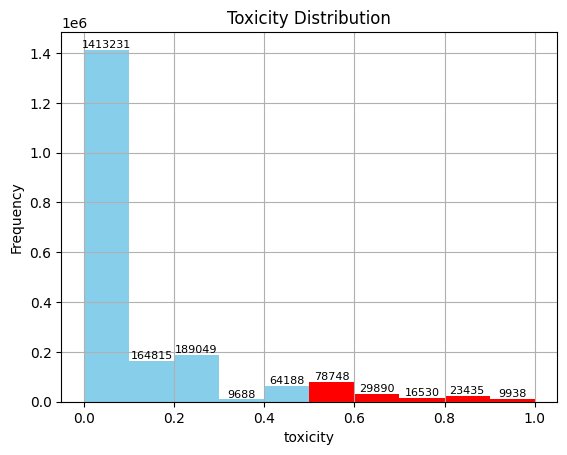

In [5]:
show_data_distribution(df_final,"toxicity","Toxicity Distribution")

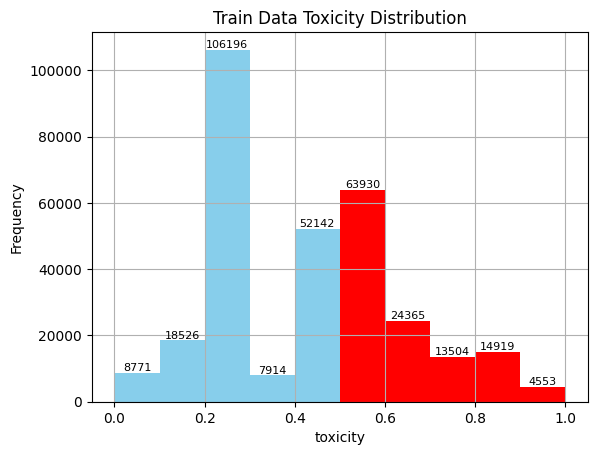

In [6]:
# Plot the histogram
show_data_distribution(df_train,"toxicity","Train Data Toxicity Distribution")

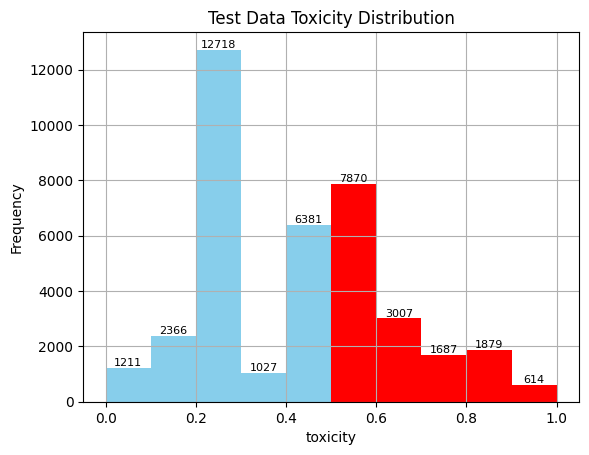

In [7]:
show_data_distribution(df_test,"toxicity","Test Data Toxicity Distribution")

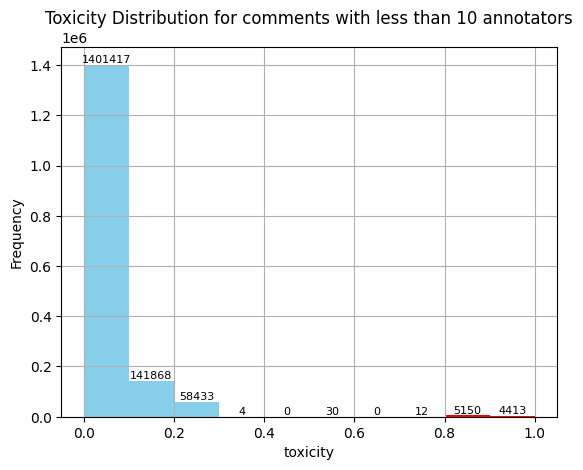

In [8]:
show_data_distribution(df_final[df_final["toxicity_annotator_count"]<10],"toxicity","Toxicity Distribution for comments with less than 10 annotators")


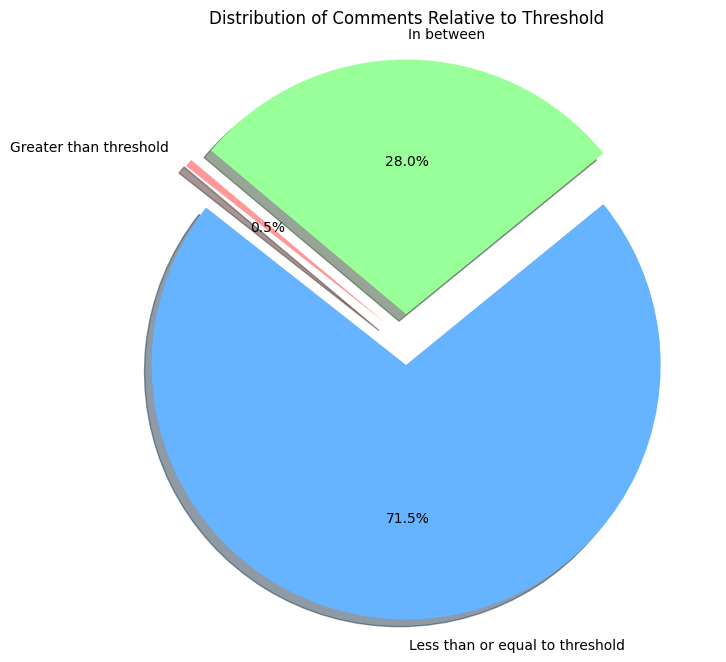

In [24]:
show_number_of_comments_greater_and_less_than_threshold(df_final,"toxicity",0.1)

Based on the data observed, we know that the majority of it is clearly non-toxic, given that we are working with a set of annotators that can range from 1 to 4,986.

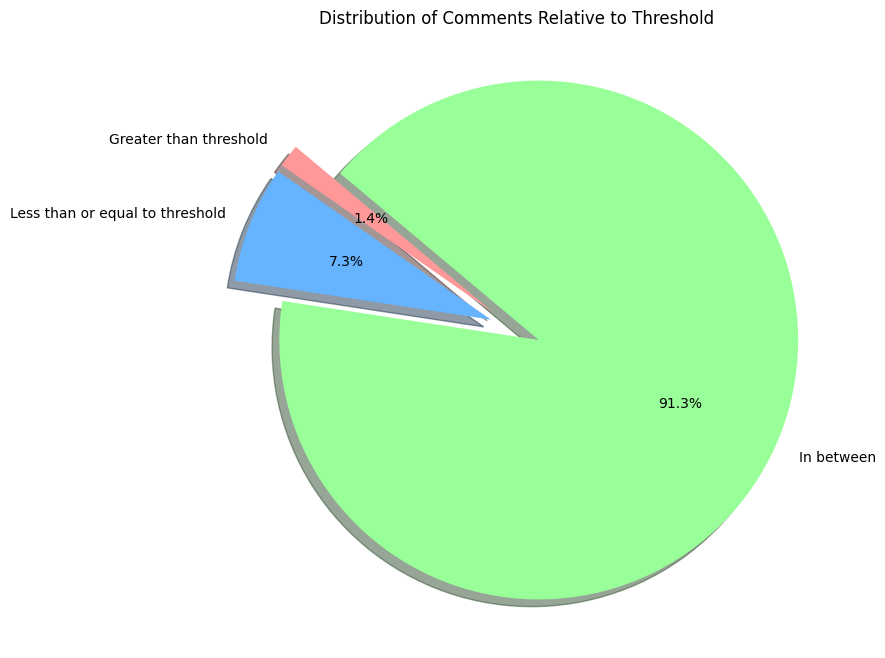

In [25]:
show_number_of_comments_greater_and_less_than_threshold(df_final[df_final["toxicity_annotator_count"]>=10],"toxicity",0.1)

We know that with a more diverse group of annotators, only a small percentage (8.7%) of comments are clearly identified as either toxic or non-toxic. This suggests that it's generally easier to determine when a comment is non-toxic than when it is toxic. However, we do have examples where the intention is quite clear.

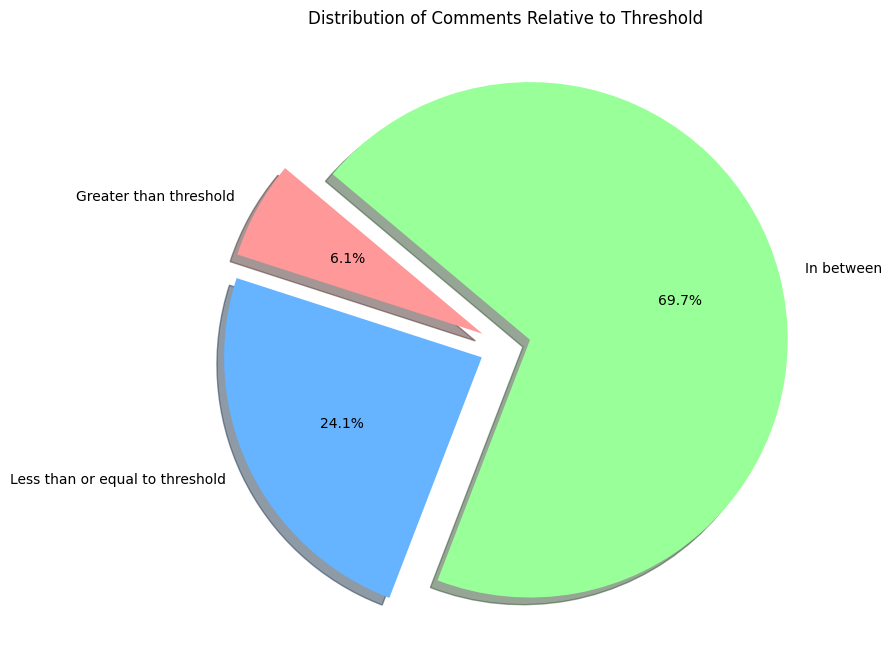

In [26]:
show_number_of_comments_greater_and_less_than_threshold(df_final[df_final["toxicity_annotator_count"]>=10],"toxicity",0.2)

In this case, we know that there are many instances where at least 80% of the annotators agreed on the classification of comments. Specifically, 24.1% of the comments were classified as non-toxic, and 6.1% as toxic.

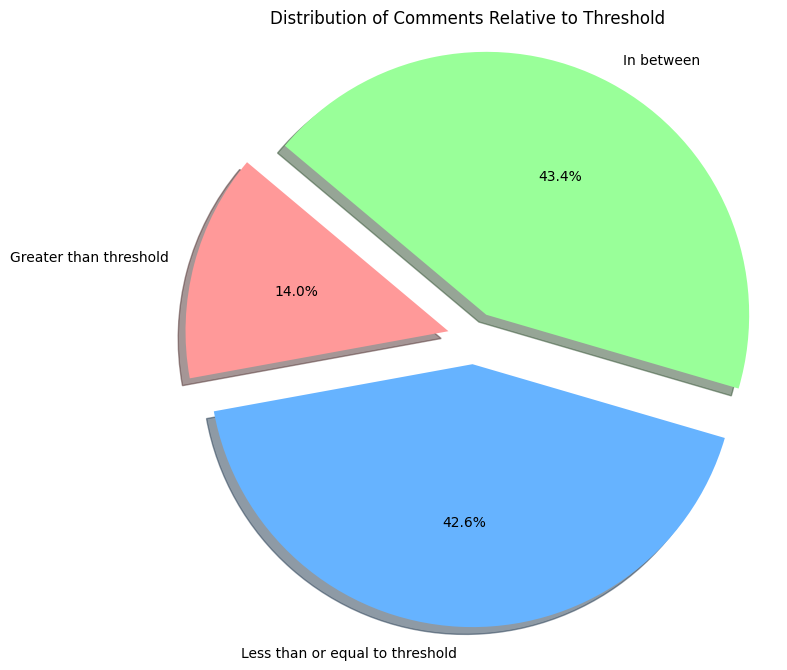

In [27]:
show_number_of_comments_greater_and_less_than_threshold(df_final[df_final["toxicity_annotator_count"]>=10],"toxicity",0.3)

In this case, we know that more than half of the data shows that at least 70% of the annotators favored the majority label.

As we increase the number of annotators, we observe that the scores previously concentrated around 0.0 to 0.1 have shifted to the range of 0.2 to 0.3. This shift occurs because a larger number of annotators increases the likelihood of a wider range of scores compared to when the population was smaller (fewer than 10).

It is interesting to analyze the percentage of elements within the bins categorized as 10-20, 20-50, and greater than 50.

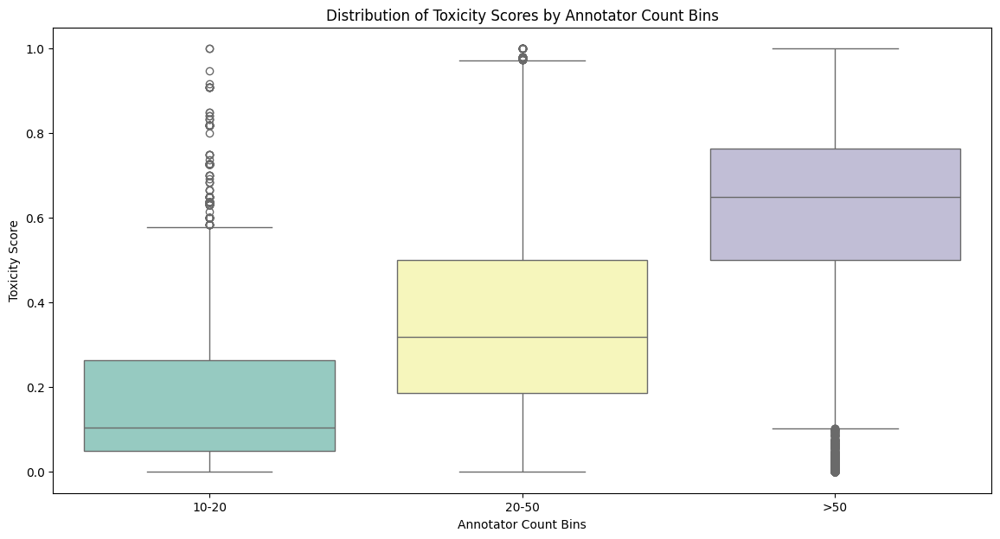

In [9]:
plot_toxicity_distribution(df_train, 'toxicity_annotator_count', 'toxicity')

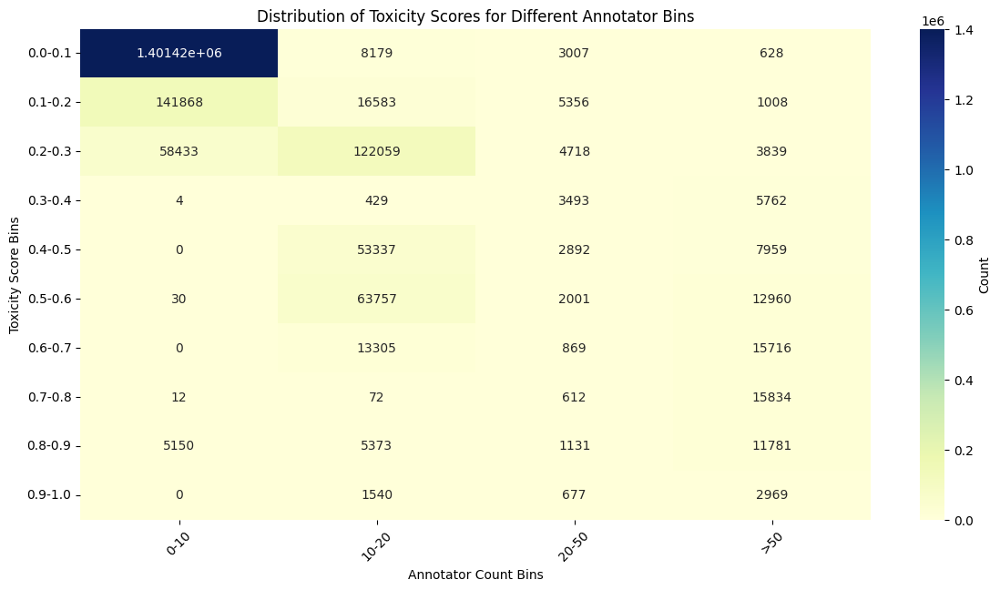

In [12]:
bins_annotator = [0,10, 20, 50, float('inf')]
labels_annotator = ['0-10','10-20', '20-50', '>50']
annotator_count_heatmap(df_final,bins_annotator,labels_annotator)

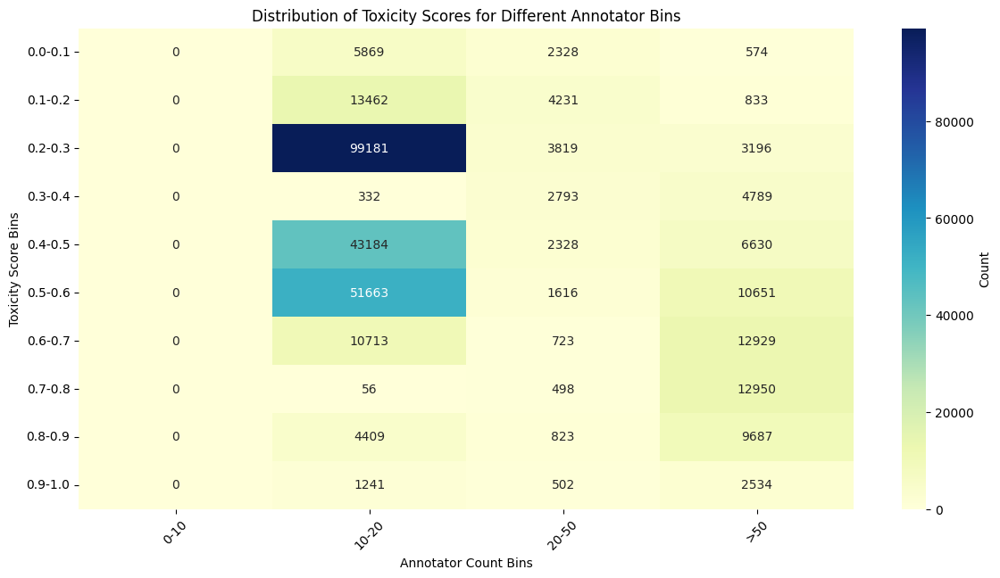

In [10]:
bins_annotator = [0,10, 20, 50, float('inf')]
labels_annotator = ['0-10','10-20', '20-50', '>50']
annotator_count_heatmap(df_train,bins_annotator,labels_annotator)

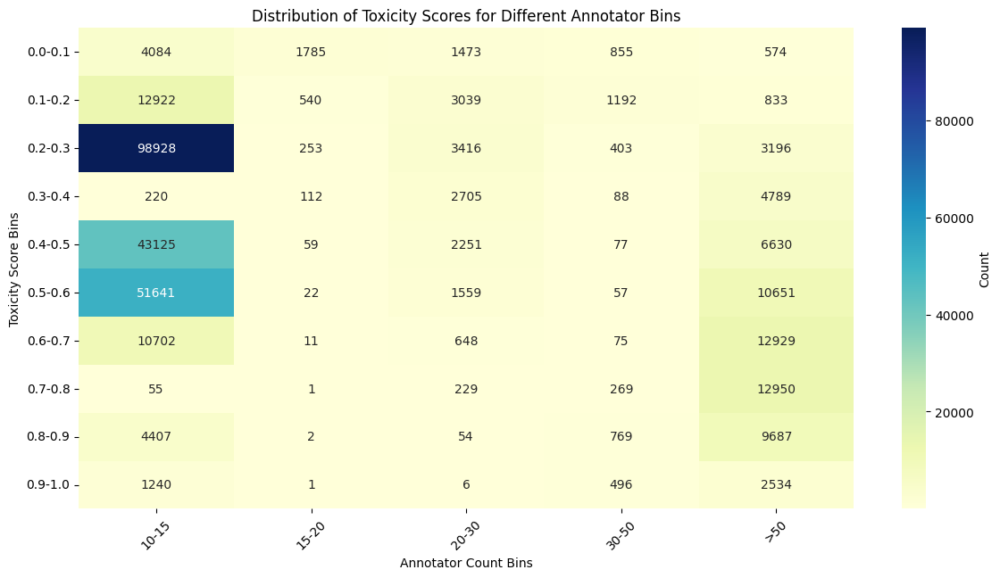

In [11]:

# Binning annotator counts
bins_annotator = [10,15, 20,30, 50, float('inf')]
labels_annotator = ['10-15','15-20','20-30', '30-50', '>50']
annotator_count_heatmap(df_train,bins_annotator,labels_annotator)

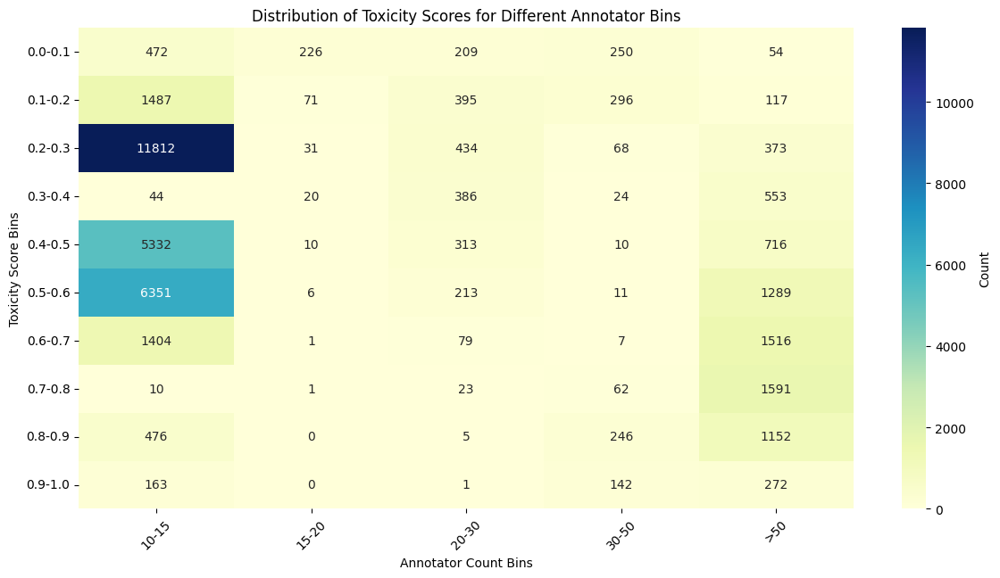

In [13]:
# Binning annotator counts
bins_annotator = [10,15, 20,30, 50, float('inf')]
labels_annotator = ['10-15','15-20','20-30', '30-50', '>50']
annotator_count_heatmap(df_test,bins_annotator,labels_annotator)

In this case, for the comments we have, we can observe that those reviewed by a larger number of annotators tend to lean more towards the toxic side. Conversely, comments that fall within the 10-15 range are generally classified as either non-toxic or uncertain.

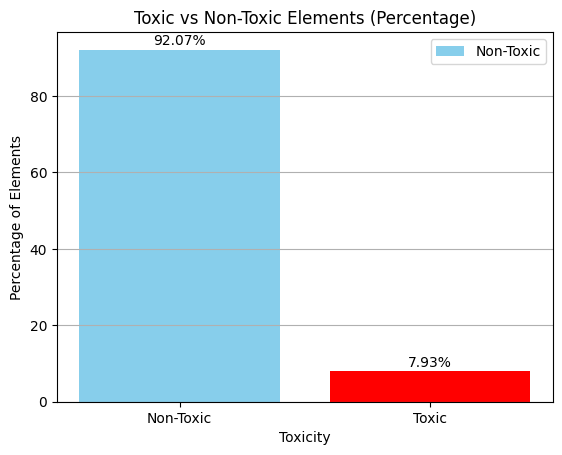

In [14]:
plot_toxic_label_count(df_final)


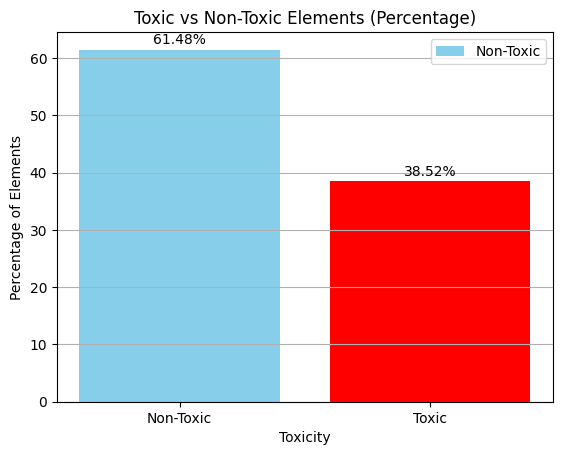

In [15]:
plot_toxic_label_count(df_train)

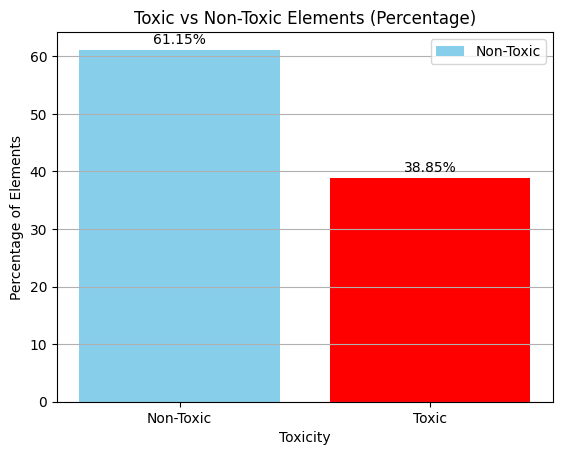

In [16]:
plot_toxic_label_count(df_test)

In [17]:
uncertain_data=df_train[(df_train["toxicity"]>=0.4) & (df_train["toxicity"]<=0.6)]

In [18]:
uncertain_data.sample(10).values

array([[5625301,
        're rail vs sky tran . we should have done it . but then, she is a republican, and this idea would have squeezed most of the graft and corruption right out of the project . of course we did not do it then . hawaii does not exist without rats all over the place, especially in government .',
        'train', 0.6, 10, '[0, 1, 1, 0, 0, 1, 1, 1, 0, 1]', '10-15',
        '0.5-0.6'],
       [6037022,
        'once again you personalize your attack as opposed to addressing the issues on a point by point basis . i thought you learned your lesson on exaggerating when you stated that others wanted machine guns at the boarder when in fact no other poster had even hinted at it . who said anything about blood greasing the wheels of industry ? pathetic . what is the word ? oh yes, reprehensible',
        'train', 0.4, 10, '[1, 1, 0, 0, 0, 1, 1, 0, 0, 0]', '10-15',
        '0.4-0.5'],
       [5922498,
        'amy botched her response to lw2 . she should have asked lw2 why she

# Toxic Annotator count

In [19]:
df_final["toxicity_annotator_count"].max()

4936

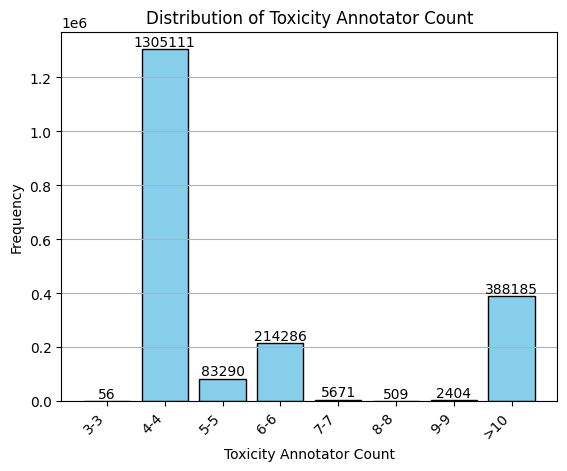

In [9]:
custom_bins = [3,4,5,6,7,8,9,10,4936]
annotation_distribution(df_final, custom_bins)

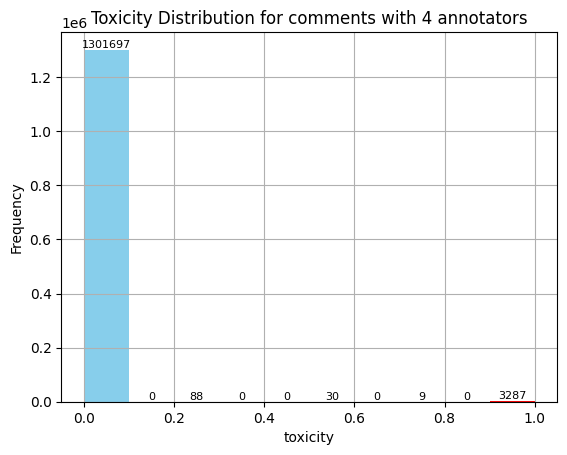

In [10]:
show_data_distribution(df_final[df_final["toxicity_annotator_count"]==4],"toxicity","Toxicity Distribution for comments with 4 annotators")

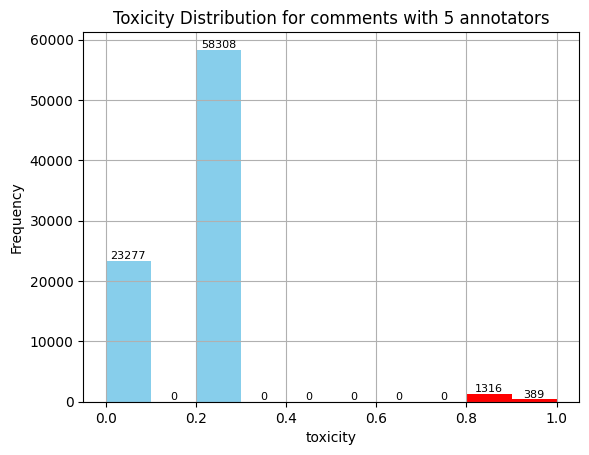

In [11]:
show_data_distribution(df_final[df_final["toxicity_annotator_count"]==5],"toxicity","Toxicity Distribution for comments with 5 annotators")

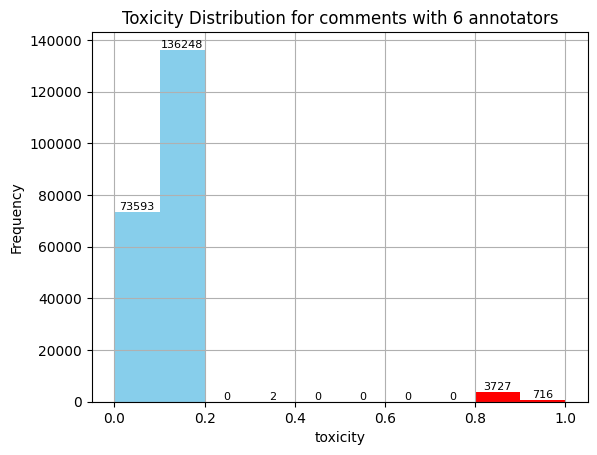

In [12]:
show_data_distribution(df_final[df_final["toxicity_annotator_count"]==6],"toxicity","Toxicity Distribution for comments with 6 annotators")

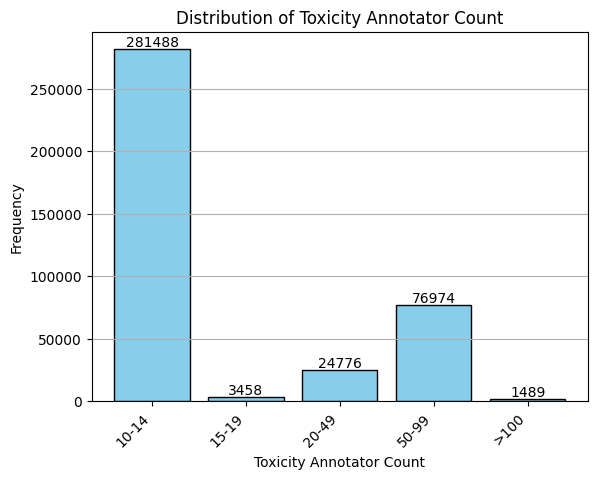

In [13]:
custom_bins = [10, 15, 20, 50,100,4936]
annotation_distribution(df_final, custom_bins)

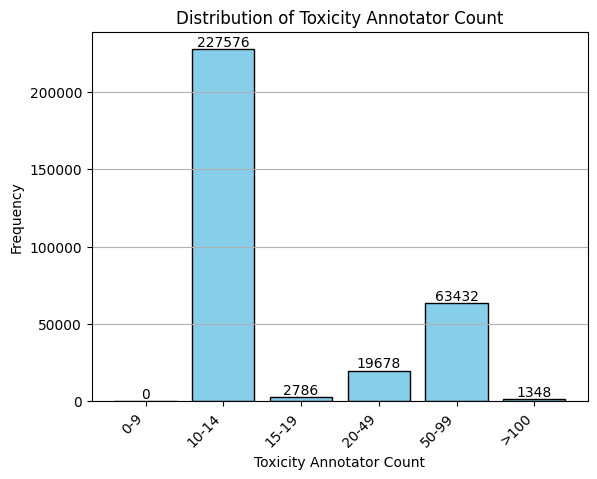

In [14]:
custom_bins = [0, 10, 15, 20, 50,100,4936]  # Example custom bins
annotation_distribution(df_train, custom_bins)

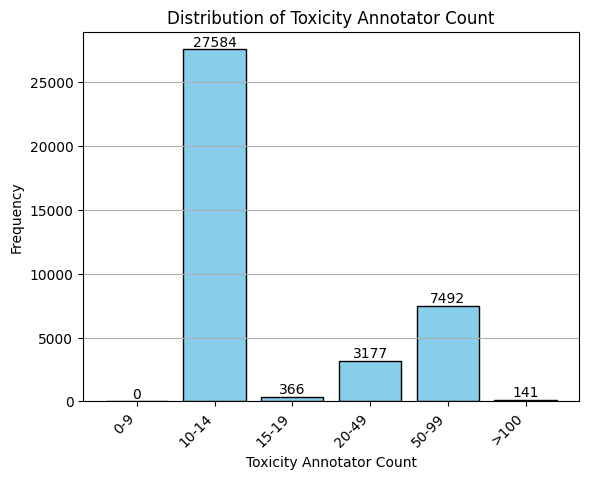

In [15]:
# Compute histogram with custom bins
custom_bins = [0, 10, 15, 20, 50,100,4936]  # Example custom bins
annotation_distribution(df_test, custom_bins)

I need to balance the test set to have information of annotators between 15-19 which i dont have.

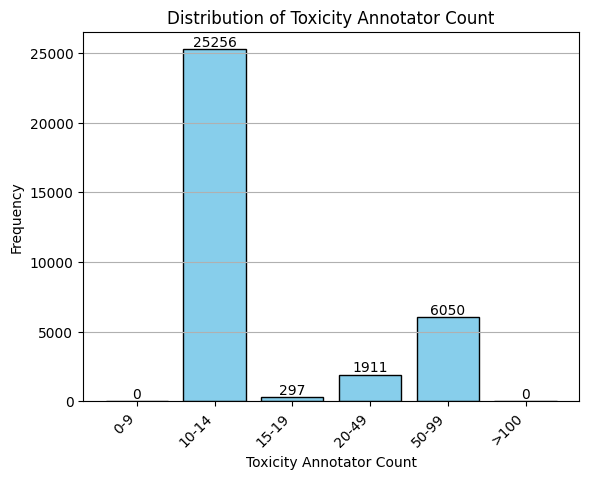

In [16]:
custom_bins = [0,10, 15, 20, 50,100,4936]  # Example custom bins
annotation_distribution(df_valid, custom_bins)

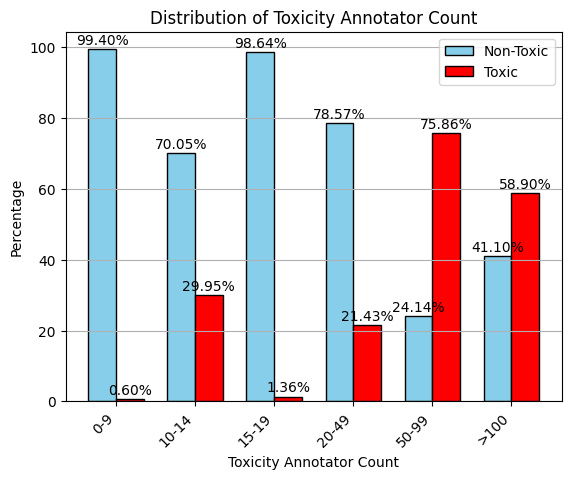

In [17]:
custom_bins = [0, 10, 15, 20, 50, 100, 4936]
annotation_toxicity_distribution(df_final, custom_bins)

/home/repo/src/notebooks/../src/visualization/graph_maker.py:161: RuntimeWarning: invalid value encountered in divide
  toxic_percentages = (toxic_counts / total_counts) * 100
/home/repo/src/notebooks/../src/visualization/graph_maker.py:162: RuntimeWarning: invalid value encountered in divide
  non_toxic_percentages = (non_toxic_counts / total_counts) * 100
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


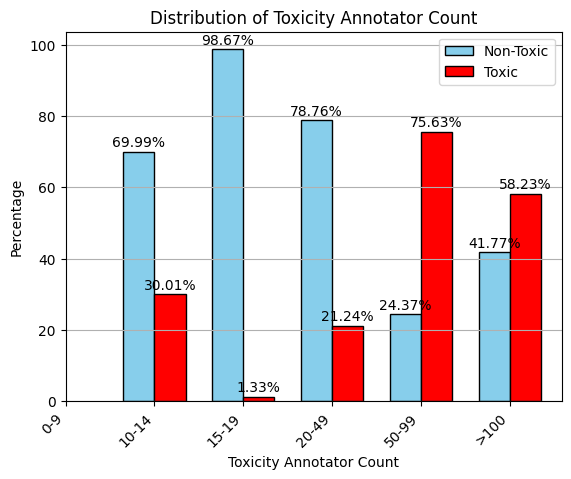

In [18]:
custom_bins = [0, 10, 15, 20, 50, 100, 4936]
annotation_toxicity_distribution(df_train, custom_bins)

/home/repo/src/notebooks/../src/visualization/graph_maker.py:161: RuntimeWarning: invalid value encountered in divide
  toxic_percentages = (toxic_counts / total_counts) * 100
/home/repo/src/notebooks/../src/visualization/graph_maker.py:162: RuntimeWarning: invalid value encountered in divide
  non_toxic_percentages = (non_toxic_counts / total_counts) * 100
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


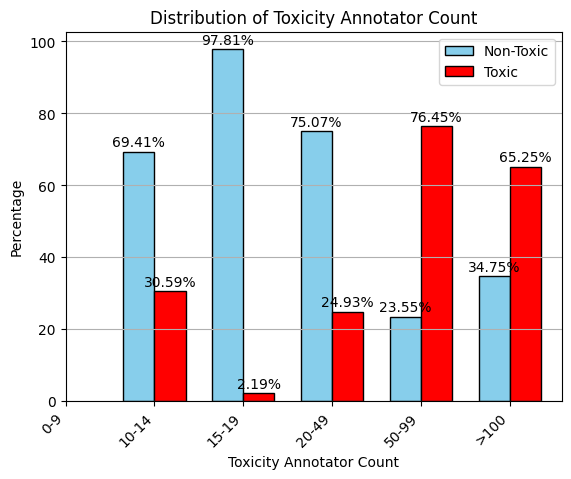

In [19]:
custom_bins = [0, 10, 15, 20, 50, 100, 4936]
annotation_toxicity_distribution(df_test, custom_bins)

/home/repo/src/notebooks/../src/visualization/graph_maker.py:161: RuntimeWarning: invalid value encountered in divide
  toxic_percentages = (toxic_counts / total_counts) * 100
/home/repo/src/notebooks/../src/visualization/graph_maker.py:162: RuntimeWarning: invalid value encountered in divide
  non_toxic_percentages = (non_toxic_counts / total_counts) * 100
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


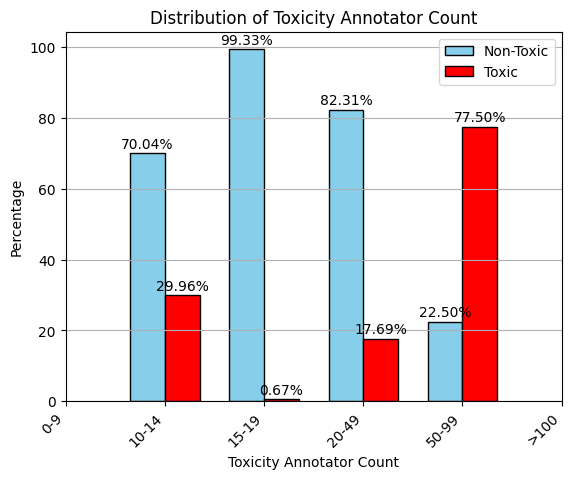

In [20]:
custom_bins = [0, 10, 15, 20, 50, 100, 4936]
annotation_toxicity_distribution(df_valid, custom_bins)

Very similar the validation except for when we have a large amount of annotators. This is due to the split and the few data points in the >100 annotator pool data.

# Disagreement computation

In [4]:
# df_final= pd.read_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_merged_data.csv")
# df_final["toxic_values"]= df_final["toxic_values"].apply(lambda x: ast.literal_eval(x))
df_train= pd.read_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_train_data.csv")
df_test= pd.read_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_test_data.csv")
df_valid= pd.read_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_valid_data.csv")

In [4]:
def disagreement_percentage(labels:np.ndarray):
    total = len(labels)
    agree_count = np.sum(labels)
    disagree_count = total - agree_count
    
    if agree_count > disagree_count:
        majority_label = 1
    elif agree_count < disagree_count:
        majority_label = 0
    else:
        # If equal, consider it as maximum disagreement
        return 0.5
    
    # Calculate the percentage of disagreement
    if agree_count / total >= 0.5:
        majority_label = 1
    else:
        majority_label = 0
        
    disagree_with_majority = np.sum(label != majority_label for label in labels)
    percentage = (disagree_with_majority / total)
    
    return percentage

In [5]:
df_final["disagreement_percentage"] = df_final["toxic_values"].apply(lambda annotations: disagreement_percentage(annotations))

/tmp/ipykernel_151519/2864385895.py:20: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  disagree_with_majority = np.sum(label != majority_label for label in labels)


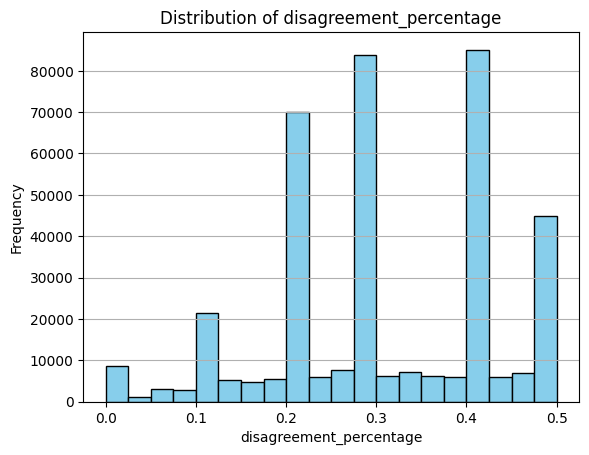

In [6]:
disagreement_distribution(df_final[df_final["toxicity_annotator_count"]>=10],"disagreement_percentage")

In [7]:
def calculate_proportions_mean_variance(group):
    """
    Calculates the variance of the mean of proportions for a given group.

    Args:
    group (list): List of binary values (0 or 1) representing occurrences and non-occurrences of events.

    Returns:
    float: The variance of the mean of proportions.
    """
    sum_yij_1 = np.sum(group)  # Sum of y_ij that are 1 (occurrences)
    sum_yij_0 = len(group) - sum_yij_1  # Sum of y_ij that are 0 (non-occurrences)
    n = len(group)  # Total number of elements in the group
    
    proportions_mean_variance = (sum_yij_1 * sum_yij_0) / (n ** 2)
    return proportions_mean_variance

In [8]:
df_final["Proportion_variance"] = df_final["toxic_values"].apply(lambda annotations: calculate_proportions_mean_variance(annotations))

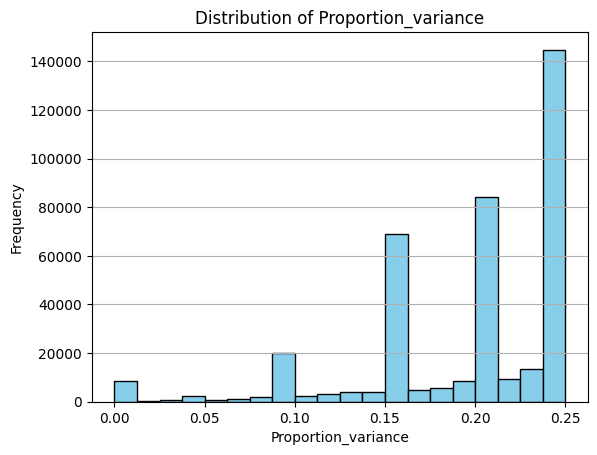

In [9]:
disagreement_distribution(df_final[df_final["toxicity_annotator_count"]>=10],"Proportion_variance")

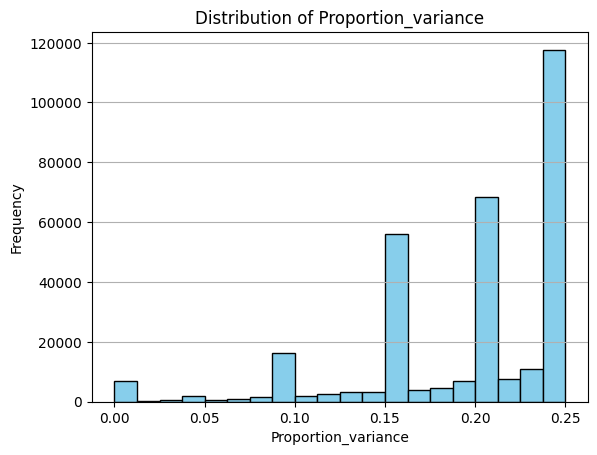

In [12]:
# df_train["toxic_values"]= df_train["toxic_values"].apply(lambda x: ast.literal_eval(x))
df_train["Proportion_variance"] = df_train["toxic_values"].apply(lambda annotations: calculate_proportions_mean_variance(annotations))
disagreement_distribution(df_train[df_train["toxicity_annotator_count"]>=10],"Proportion_variance")

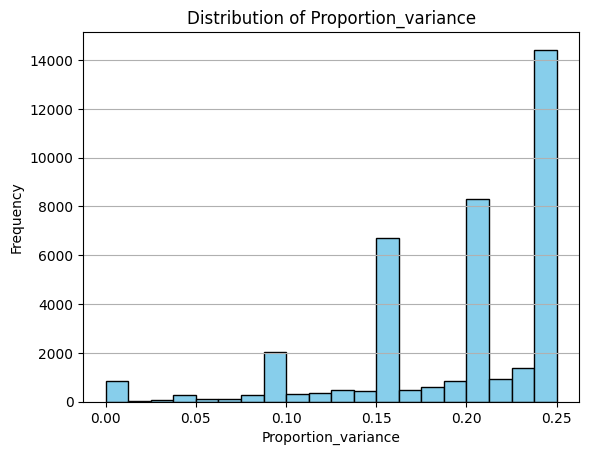

In [14]:
df_test["toxic_values"]= df_test["toxic_values"].apply(lambda x: ast.literal_eval(x))
df_test["Proportion_variance"] = df_test["toxic_values"].apply(lambda annotations: calculate_proportions_mean_variance(annotations))
disagreement_distribution(df_test[df_test["toxicity_annotator_count"]>=10],"Proportion_variance")

In [22]:
correlation = df_final[df_final["toxicity_annotator_count"]>=10]['disagreement_percentage'].corr(df_final[df_final["toxicity_annotator_count"]>=10]['Proportion_variance'])

print(f"Correlation between variable1 and variable2: {correlation}")

Correlation between variable1 and variable2: 0.946517530298479


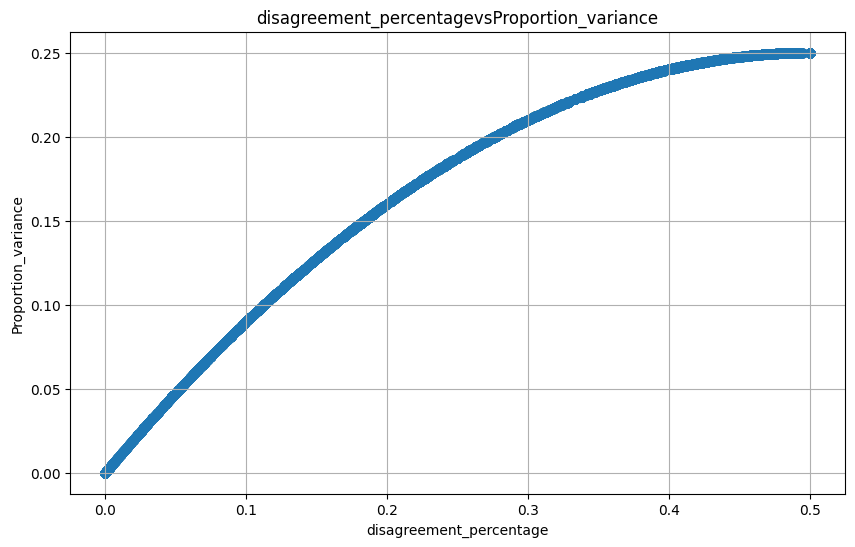

In [15]:
disagreement_method_comparison(df_final[df_final["toxicity_annotator_count"]>=10],"disagreement_percentage","Proportion_variance")

In [16]:
def distance_based_metrics(group):
    """
    Calculates the variance of the mean of proportions for a given group.

    Args:
    group (list): List of binary values (0 or 1) representing occurrences and non-occurrences of events.

    Returns:
    float: The variance of the mean of proportions.
    """
    mean = np.mean(group)
     # Sum of y_ij that are 1 (occurrences)
    certainty=abs(0.5-mean)
    uncertainty=1-certainty*2
    return uncertainty

In [17]:
df_final["Distance_based"] = df_final["toxic_values"].apply(lambda annotations: distance_based_metrics(annotations))

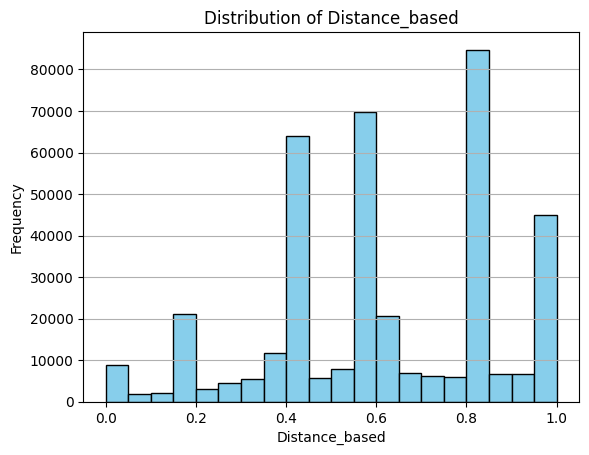

In [18]:
disagreement_distribution(df_final[df_final["toxicity_annotator_count"]>=10],"Distance_based")

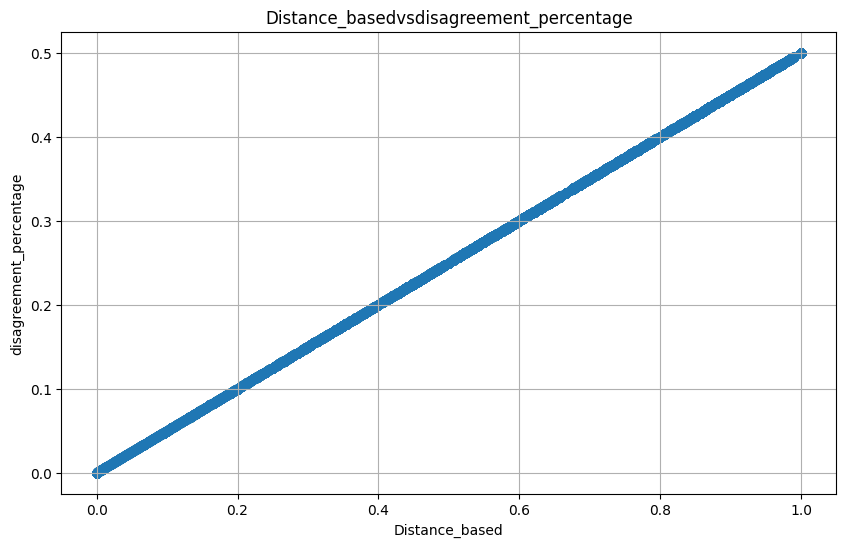

In [19]:
disagreement_method_comparison(df_final[df_final["toxicity_annotator_count"]>=10],"Distance_based","disagreement_percentage")

In [12]:
df_final[df_final["toxicity_annotator_count"]>=10].describe()

,id,toxicity,toxicity_annotator_count,Distance_based
count,3.881850e+05,388185.000000,388185.000000,388185.000000
mean,4.076372e+06,0.414178,28.267249,0.612737
std,2.522840e+06,0.213614,96.122052,0.249023
min,5.985600e+04,0.000000,10.000000,0.000000
25%,8.616780e+05,0.250000,10.000000,0.400000
50%,5.362506e+06,0.400000,10.000000,0.600000
75%,5.967335e+06,0.587500,22.000000,0.800000
max,7.194637e+06,1.000000,4936.000000,1.000000


We can observe that the mean of disagreement is arounf 0.60 which is that the 30% of disagreement is the most common being around 20% and 40% the quantile

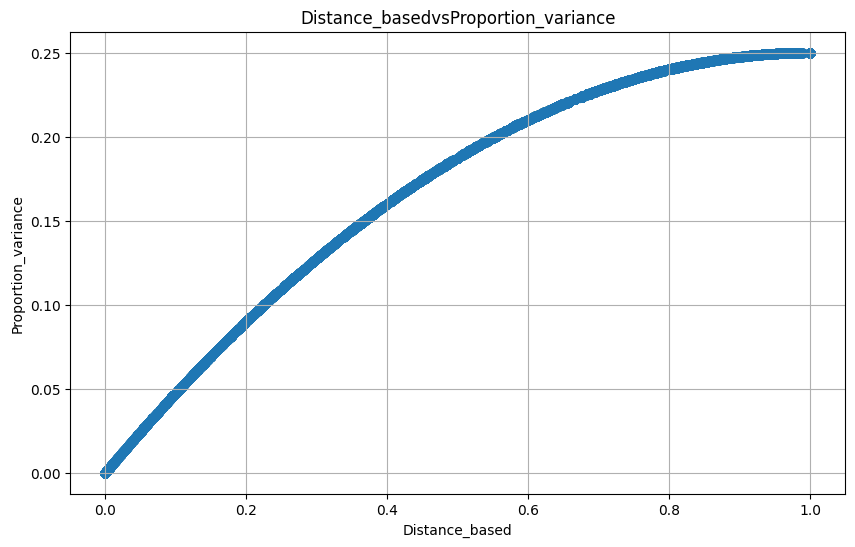

In [20]:
disagreement_method_comparison(df_final[df_final["toxicity_annotator_count"]>=10],"Distance_based","Proportion_variance")

In [21]:
def kl_divergence_binary(group):
   
    p0 = sum(group) / len(group)
    p1 = 1 - p0
    
    # Check for certainty and return 1 (maximum value)
    if p0 == 1 or p1 == 1:
        return 1-1.0
    
    # Compute KL divergence
    kl_div = p0 * np.log(2 * p0) + p1 * np.log(2 * p1)
    
    # Normalize by maximum possible KL divergence for binary data
    max_kl_div = np.log(2)
    scaled_kl_div = kl_div / max_kl_div
    
    return 1-scaled_kl_div

In [22]:
df_final["kl_divergence_binary"] = df_final["toxic_values"].apply(lambda annotations: kl_divergence_binary(annotations))

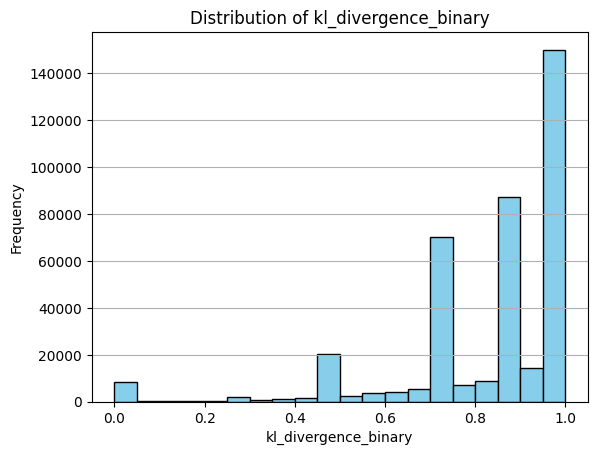

In [23]:
disagreement_distribution(df_final[df_final["toxicity_annotator_count"]>=10],"kl_divergence_binary")

In [24]:
df_final[df_final["toxicity_annotator_count"]>=10].describe()

,id,toxicity,toxicity_annotator_count,disagreement_percentage,Proportion_variance,Distance_based,kl_divergence_binary
count,3.881850e+05,388185.000000,388185.000000,388185.000000,388185.000000,388185.000000,388185.000000
mean,4.076372e+06,0.414178,28.267249,0.306368,0.197004,0.612737,0.829585
std,2.522840e+06,0.213614,96.122052,0.124512,0.055861,0.249023,0.199652
min,5.985600e+04,0.000000,10.000000,0.000000,0.000000,0.000000,0.000000
25%,8.616780e+05,0.250000,10.000000,0.200000,0.160000,0.400000,0.721928
50%,5.362506e+06,0.400000,10.000000,0.300000,0.210000,0.600000,0.881291
75%,5.967335e+06,0.587500,22.000000,0.400000,0.240000,0.800000,0.970951
max,7.194637e+06,1.000000,4936.000000,0.500000,0.250000,1.000000,1.000000


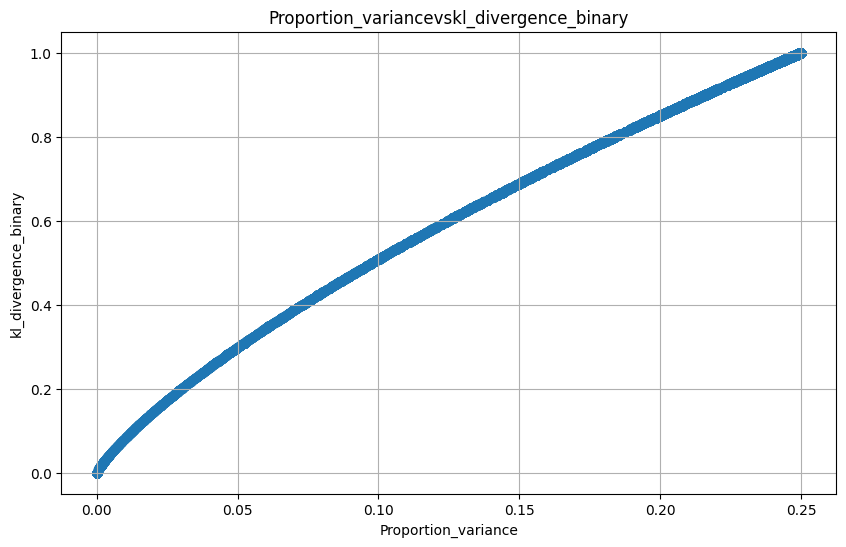

In [26]:
disagreement_method_comparison(df_final[df_final["toxicity_annotator_count"]>=10],"Proportion_variance","kl_divergence_binary")

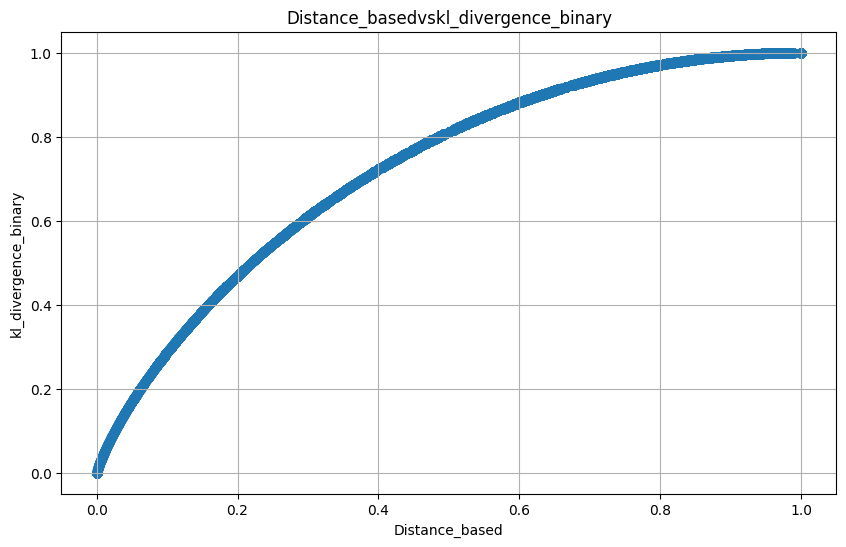

In [27]:
disagreement_method_comparison(df_final[df_final["toxicity_annotator_count"]>=10],"Distance_based","kl_divergence_binary")

In [28]:
def entropy_binary_distribution(group):
    """
    Calculates the entropy of a binary distribution for a given group.

    Args:
    group (list): List of binary values (0 or 1) representing occurrences and non-occurrences of events.

    Returns:
    float: The entropy of the binary distribution.
    """
    # Convert the list to a numpy array for easier computation
    group = np.array(group)
    
    # Calculate the probability of occurrence of 1s
    p = np.mean(group)
    
    # If p is 0 or 1, the entropy is 0
    if p == 0 or p == 1:
        return 0.0
    
    # Calculate the entropy of the binary distribution
    entropy = -p * np.log2(p) - (1 - p) * np.log2(1 - p)
    
    return entropy

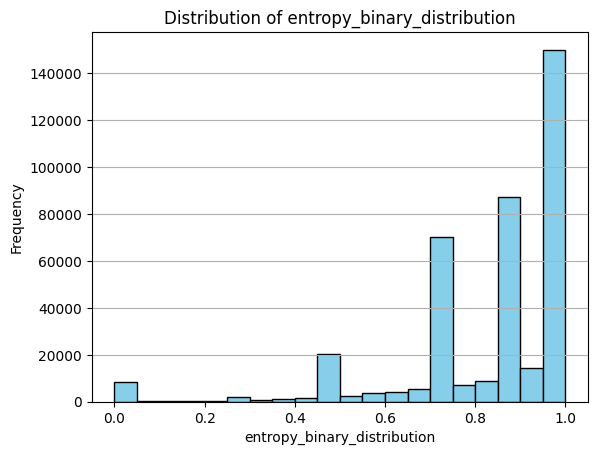

In [29]:
df_final["entropy_binary_distribution"] = df_final["toxic_values"].apply(lambda annotations: entropy_binary_distribution(annotations))
disagreement_distribution(df_final[df_final["toxicity_annotator_count"]>=10],"entropy_binary_distribution")

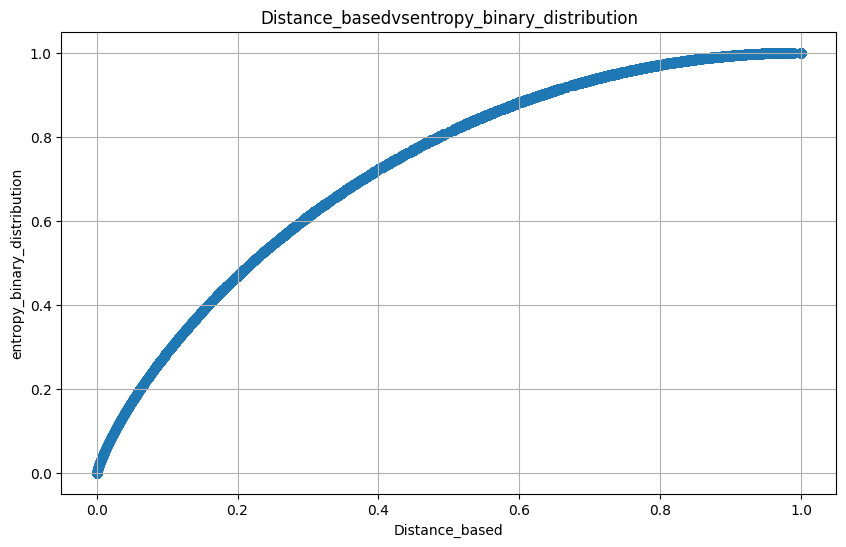

In [32]:
disagreement_method_comparison(df_final[df_final["toxicity_annotator_count"]>=10],"Distance_based","entropy_binary_distribution")

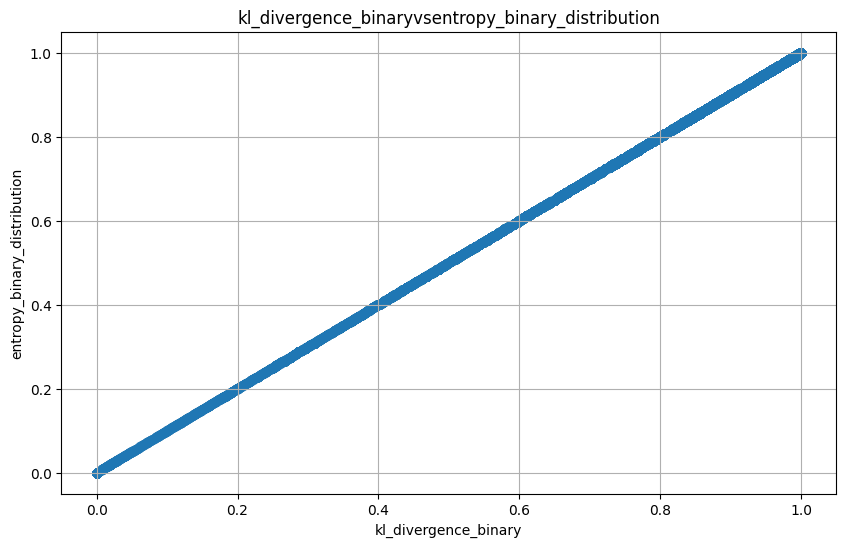

In [33]:
disagreement_method_comparison(df_final[df_final["toxicity_annotator_count"]>=10],"kl_divergence_binary","entropy_binary_distribution")

In [34]:
def uncertainty_variance(group):
    p = np.mean(group)
    uncertainty = p * (1 - p)
    return uncertainty

In [35]:
df_final["uncertainty_variance"] = df_final["toxic_values"].apply(lambda annotations: uncertainty_variance(annotations))

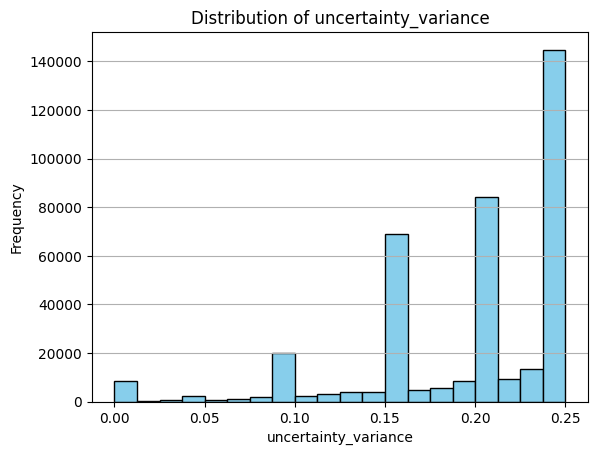

In [36]:
disagreement_distribution(df_final[df_final["toxicity_annotator_count"]>=10],"uncertainty_variance")

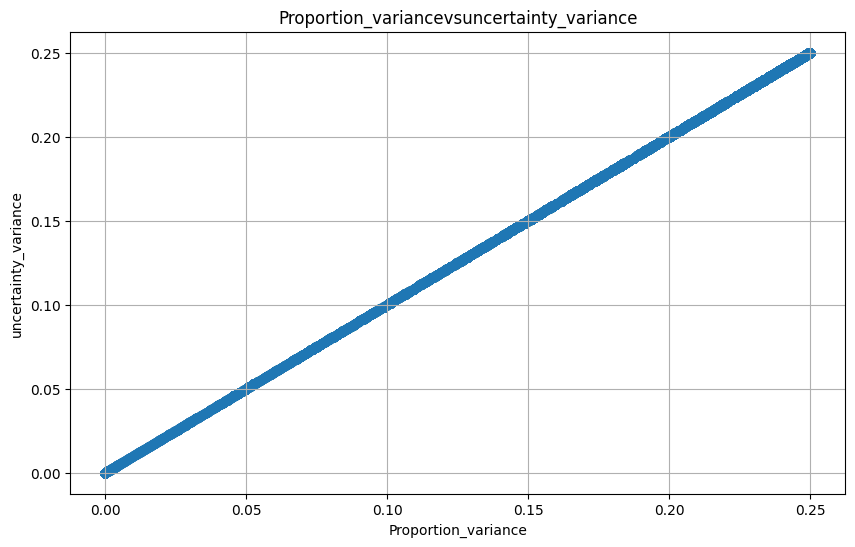

In [37]:
disagreement_method_comparison(df_final[df_final["toxicity_annotator_count"]>=10],"Proportion_variance","uncertainty_variance")

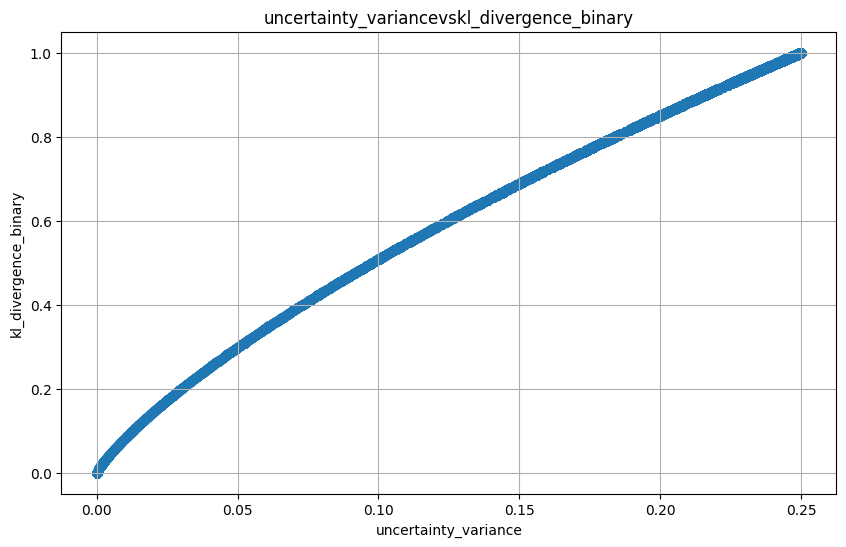

In [39]:
disagreement_method_comparison(df_final[df_final["toxicity_annotator_count"]>=10],"uncertainty_variance","kl_divergence_binary")

In this case several way of calculating the annotation disagreements has been observe based on several previous research about the subject:
- Disagreement percentage was introduced in the article "Everyone’s Voice Matters: Quantifying Annotation Disagreement Using Demographic Information". It is as the percentage of people that disagree with the mayority of label.
- Annotations variance calculated as he proportion of people that agree for each label as introduced in "Dealing with Disagreements: Looking Beyond the Majority Vote in Subjective Annotations".
- Distanced based metric, calculates the diference from the 0.5 to the actual prediction as a uncertainty metric being mean values near 0.5 the most uncertain value.
- Kl divergence to the uniform distribution 0f p 0.5 is another way of measuring the uncertainty of annotation. This metric is based on the article "Beyond Black & White: Leveraging Annotator Disagreement via Soft-Label Multi-Task Learning". In this case they use it as a loss but as it also measures the disagreement we have use it knowing it relation to information theory.
- Uncertainty as the entropy binary distribution is a metric that is based on information theory to quantify the uncertainty of a variable given its distribution.
- Uncertainty variance computation is based on the article "Measuring and Improving Model-Moderator Collaboration using Uncertainty Estimation". 

We also have analise how they correlate to find similarities between disagreement computation methods:

- Annotation variance as proportions and uncertainty variance are exactly the same.  

- Disagreement percentage and distance based is the same.

- Kullback leibler is the same as calculating the entropy binary distribution.

The uncertainty quantification methods we are going to be using is: uncertainty variance, disagreement based and Kullback leibler to the uniform distribution. The First one is quite different in terms of value range, 0 to 0.25.


## Disagreement vs toxicity

In [10]:
from src.visualization.graph_maker import disagreement_toxicity_distribution
from src.utils.compute_disagreement import distance_based_metrics,entropy_binary_distribution,uncertainty_variance

In [4]:
df_final["Entropy_binary_distribution"] = df_final["toxic_values"].apply(lambda annotations: entropy_binary_distribution(annotations))

In [ ]:
df_final["Distance_based"] = df_final["toxic_values"].apply(lambda annotations: distance_based_metrics(annotations))

In [6]:
df_test["toxic_values"]= df_test["toxic_values"].apply(lambda x: ast.literal_eval(x))


In [7]:
df_test["Distance_based"] = df_test["toxic_values"].apply(lambda annotations: distance_based_metrics(annotations))

In [8]:
df_test["Entropy_binary_distribution"] = df_test["toxic_values"].apply(lambda annotations: entropy_binary_distribution(annotations))

In [5]:
df_final

,id,comment_text,split,toxicity,toxicity_annotator_count,toxic_values,Distance_based
0,1083994,He got his money... now he lies in wait till a...,train,0.373134,67,"[0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, ...",0.746269
1,650904,Mad dog will surely put the liberals in mental...,train,0.605263,76,"[0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, ...",0.789474
2,5902188,And Trump continues his lifelong cowardice by ...,train,0.666667,63,"[1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, ...",0.666667
3,7084460,"""while arresting a man for resisting arrest"".\...",test,0.815789,76,"[1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, ...",0.368421
4,5410943,Tucker and Paul are both total bad ass mofo's.,train,0.550000,80,"[1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, ...",0.900000
...,...,...,...,...,...,...,...
1999507,1018736,Another man shamming article. If white men did...,train,0.400000,10,"[0, 1, 0, 0, 0, 1, 0, 0, 1, 1]",0.800000
1999508,340016,"""no matter what is put in front of you regardi...",train,0.230769,26,"[1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, ...",0.461538
1999509,919629,The Democrat party aided and abetted by it's M...,train,0.400000,10,"[1, 0, 1, 1, 0, 0, 0, 0, 1, 0]",0.800000
1999510,5165492,I just don't find her a very good representati...,train,0.400000,10,"[1, 0, 0, 1, 0, 1, 0, 1, 0, 0]",0.800000


In [5]:
def generate_graph(df,disagreement_columns):
    df["toxic"]=df["toxicity"].swifter.apply(lambda x: 1 if x>=0.5 else 0)
    # Step 2: Bin the data
    bins = np.arange(0, 1.1, 0.1)
    df['bin'] = pd.cut(df[disagreement_columns], bins, include_lowest=True)
    print(df['bin'].value_counts())
    # Step 3: Calculate counts and percentages for each bin
    bin_counts = df.groupby(['bin', 'toxic']).size().unstack(fill_value=0)
    bin_counts['total'] = bin_counts.sum(axis=1)
    bin_counts['toxic_percentage'] = bin_counts[1] / bin_counts['total'] * 100
    bin_counts['not_toxic_percentage'] = bin_counts[0] / bin_counts['total'] * 100

    # Step 4: Plot the data
    fig, ax1 = plt.subplots(figsize=(12, 8))

    # Bar plot for counts
    bin_counts[[0, 1]].plot(kind='bar', stacked=True, ax=ax1, color=['blue', 'red'], alpha=0.6)
    ax1.set_ylabel('Counts')
    ax1.set_title('Distribution of Disagreement Scores (Toxic vs Not Toxic)')
    ax1.legend(['Not Toxic', 'Toxic'], loc='upper left')

    # Percentage plot
    ax2 = ax1.twinx()
    bin_counts[['not_toxic_percentage', 'toxic_percentage']].plot(kind='line', ax=ax2, marker='o', linestyle='--', color=['blue', 'red'])
    ax2.set_ylabel('Percentage')
    ax2.legend(['Not Toxic Percentage', 'Toxic Percentage'], loc='upper right')

    plt.xticks(range(len(bin_counts)), [f'{b.left:.1f}-{b.right:.1f}' for b in bin_counts.index], rotation=45)
    plt.show()

Pandas Apply: 100%|██████████| 388185/388185 [00:00<00:00, 1888687.70it/s]
/tmp/ipykernel_74154/3002510253.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["toxic"]=df["toxicity"].swifter.apply(lambda x: 1 if x>=0.5 else 0)
/tmp/ipykernel_74154/3002510253.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.cut(df[disagreement_columns], bins, include_lowest=True)


bin
(0.7, 0.8]       91460
(0.5, 0.6]       89744
(0.3, 0.4]       75258
(0.9, 1.0]       51271
(0.1, 0.2]       23268
(0.6, 0.7]       13400
(0.8, 0.9]       12405
(0.4, 0.5]       12401
(-0.001, 0.1]    10531
(0.2, 0.3]        8447
Name: count, dtype: int64


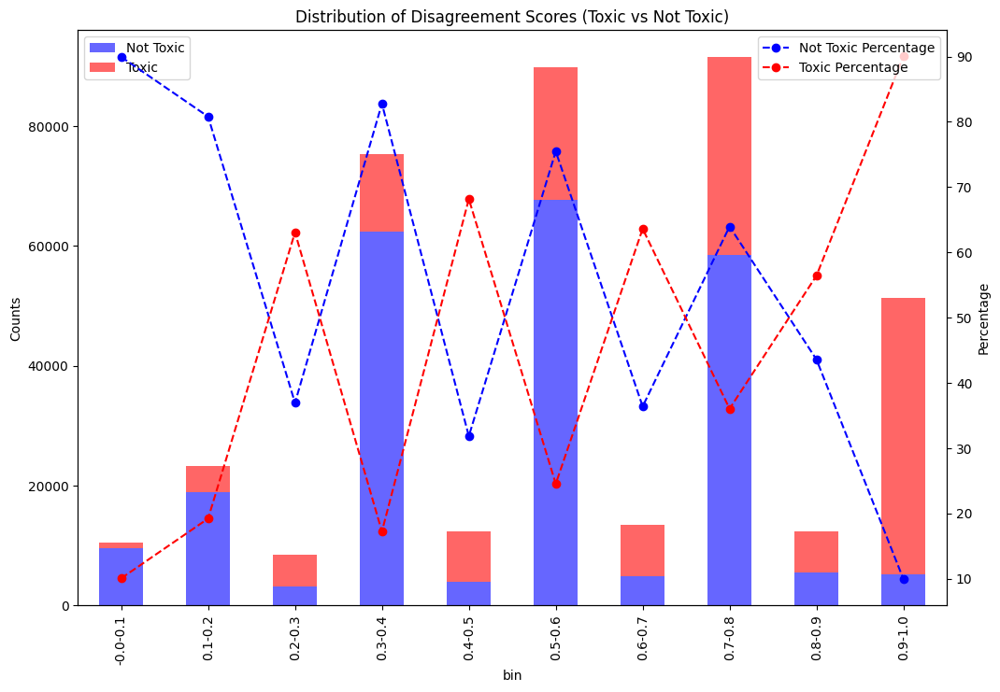

In [9]:
generate_graph(df_final[df_final["toxicity_annotator_count"]>=10],"Distance_based")

Pandas Apply: 100%|██████████| 388185/388185 [00:00<00:00, 1605678.37it/s]
/tmp/ipykernel_139659/3002510253.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["toxic"]=df["toxicity"].swifter.apply(lambda x: 1 if x>=0.5 else 0)
/tmp/ipykernel_139659/3002510253.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bin'] = pd.cut(df[disagreement_columns], bins, include_lowest=True)


bin
(0.9, 1.0]       164579
(0.8, 0.9]        95998
(0.7, 0.8]        77294
(0.4, 0.5]        21969
(0.6, 0.7]         9283
(-0.001, 0.1]      8420
(0.5, 0.6]         5936
(0.2, 0.3]         2417
(0.3, 0.4]         1682
(0.1, 0.2]          607
Name: count, dtype: int64


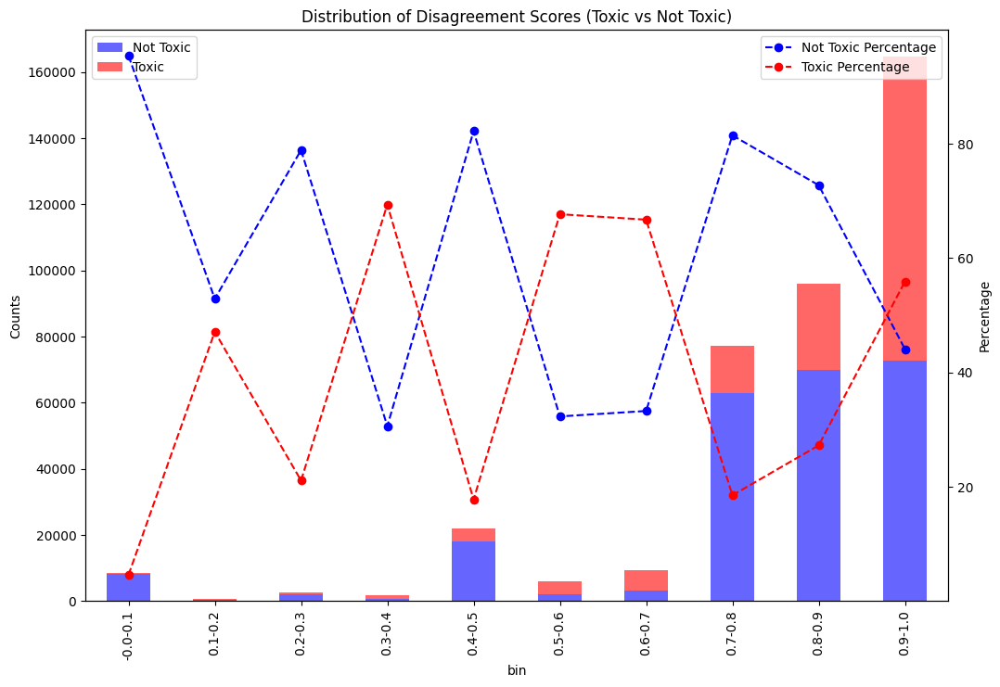

In [6]:
generate_graph(df_final[df_final["toxicity_annotator_count"]>=10],"Entropy_binary_distribution")

Pandas Apply: 100%|██████████| 38861/38861 [00:00<00:00, 1727591.98it/s]


bin
(0.7, 0.8]       9157
(0.5, 0.6]       8869
(0.3, 0.4]       7366
(0.9, 1.0]       5064
(0.1, 0.2]       2383
(0.6, 0.7]       1358
(0.4, 0.5]       1294
(0.8, 0.9]       1257
(-0.001, 0.1]    1116
(0.2, 0.3]        997
Name: count, dtype: int64


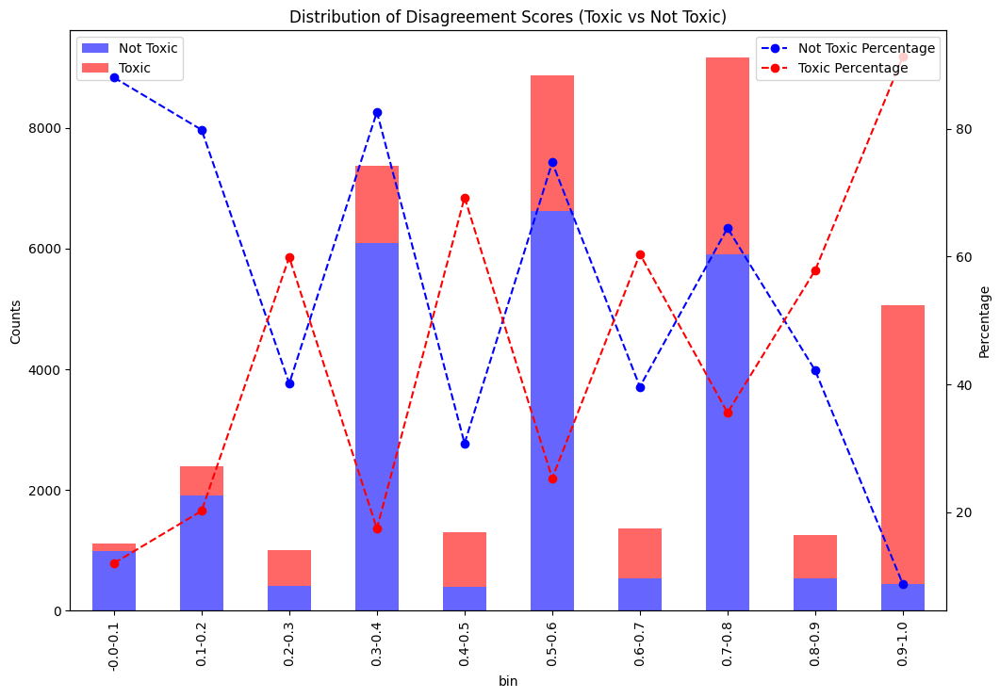

In [10]:
generate_graph(df_test[df_test["toxicity_annotator_count"]>=10],"Distance_based")

In [11]:
def disagreement_versus_toxicity_scores(df,disagreement_column):
    bins_toxicity = np.arange(0, 1.1, 0.1)
    labels_annotator= [f'{i:.1f}-{i+0.1:.1f}' for i in bins_toxicity[:-1]]
    # Binning annotator counts
    df['annotator_bins'] = pd.cut(df[disagreement_column], bins=bins_toxicity, labels=labels_annotator, right=False)

    # Binning toxicity scores into increments of 0.1
    bins_toxicity = np.arange(0, 1.1, 0.1)
    labels_toxicity = [f'{i:.1f}-{i+0.1:.1f}' for i in bins_toxicity[:-1]]
    df['toxicity_bins'] = pd.cut(df['toxicity'], bins=bins_toxicity, labels=labels_toxicity, right=False)

    # Group by the bins and count occurrences
    toxicity_distribution = df.groupby(['annotator_bins', 'toxicity_bins']).size().reset_index(name='count')

    # Pivot the table for better visualization
    toxicity_pivot = toxicity_distribution.pivot(index='toxicity_bins', columns='annotator_bins', values='count').fillna(0)

    # Plotting
    plt.figure(figsize=(14, 7))
    sns.heatmap(toxicity_pivot, cmap="YlGnBu", cbar_kws={'label': 'Count'}, annot=True, fmt='g')
    plt.title('Real Distribution of Toxicity Scores for Real Different Disagreement Bins')
    plt.xlabel('Disagreement Count Bins')
    plt.ylabel('Toxicity Score Bins')
    plt.xticks(rotation=45)
    plt.yticks(rotation=0)
    plt.show()

/tmp/ipykernel_119804/742741774.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['annotator_bins'] = pd.cut(df[disagreement_column], bins=bins_toxicity, labels=labels_annotator, right=False)
/tmp/ipykernel_119804/742741774.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['toxicity_bins'] = pd.cut(df['toxicity'], bins=bins_toxicity, labels=labels_toxicity, right=False)


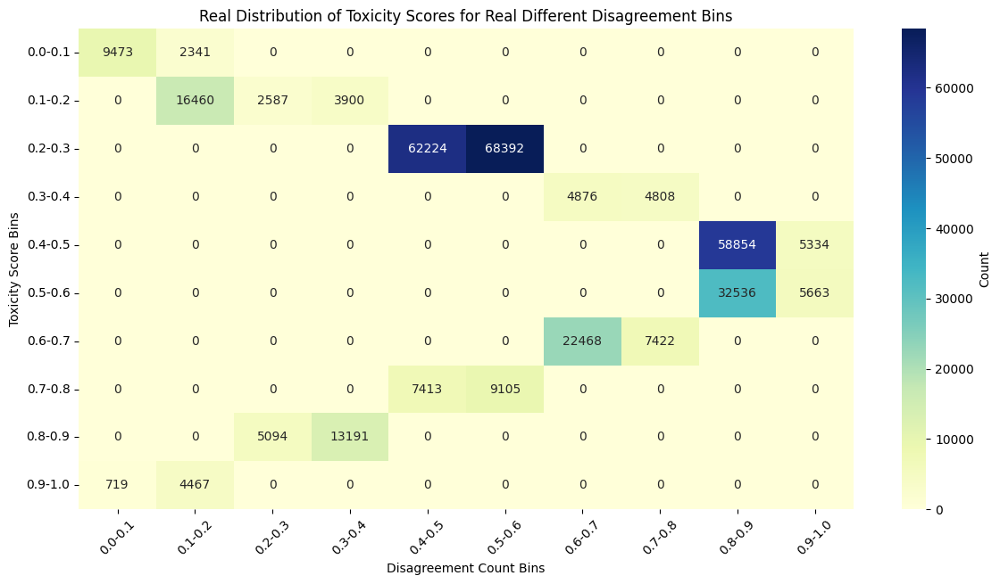

In [6]:
disagreement_versus_toxicity_scores(df_final[df_final["toxicity_annotator_count"]>=10],"Distance_based")

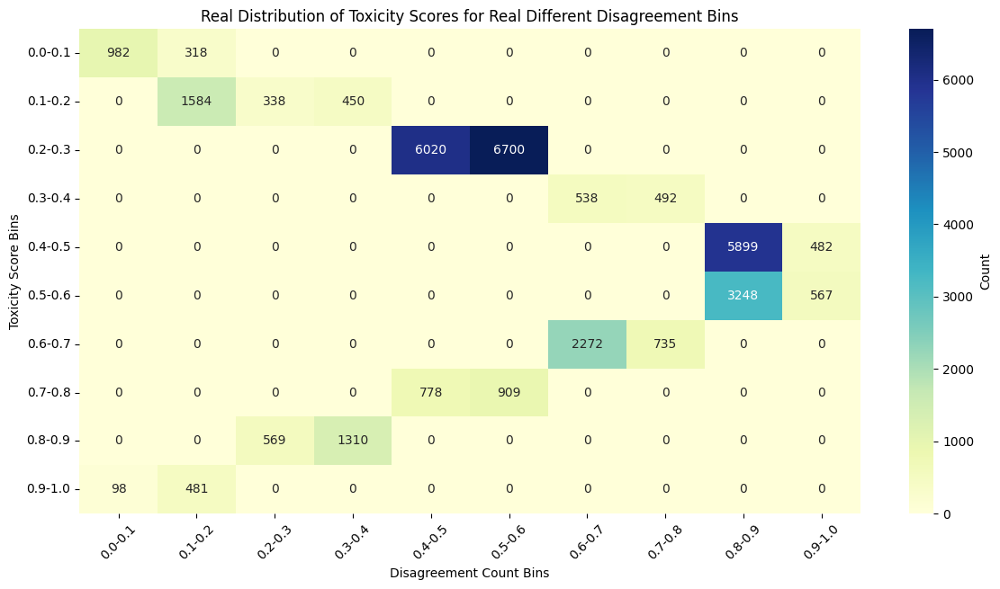

In [12]:
disagreement_versus_toxicity_scores(df_test[df_test["toxicity_annotator_count"]>=10],"Distance_based")

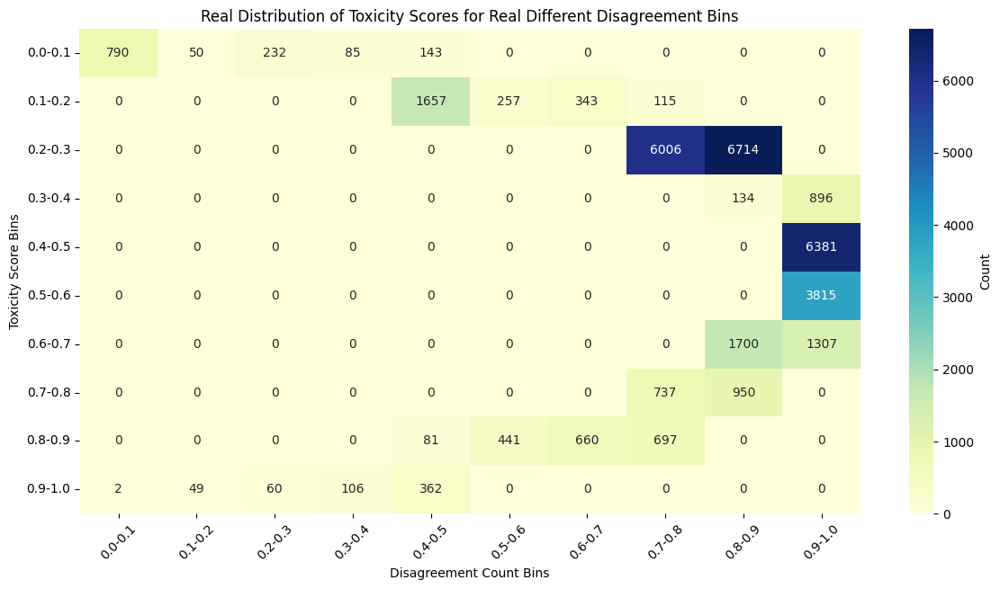

In [13]:
disagreement_versus_toxicity_scores(df_test[df_test["toxicity_annotator_count"]>=10],"Entropy_binary_distribution")

In [16]:
df_test[df_test["toxicity"]<=0.1]

,id,comment_text,split,toxicity,toxicity_annotator_count,toxic_values,Distance_based,Entropy_binary_distribution
4,7175529,"I have, Don Nom De Lantinos PoliticallyIncorre...",test,0.000000,11,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",0.000000,0.000000
26,7052981,Trump is just cleaning up one of Obama's messes,test,0.000000,34,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.000000,0.000000
28,7070002,Wait wait wait....Hawaii is legalizing Marijua...,test,0.051282,39,"[0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.102564,0.291818
57,7052697,"Yes, let's fire all the journalists with whom ...",test,0.071429,42,"[0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.142857,0.371232
64,7103707,I guess...if it showed a better looking garage...,test,0.055172,1160,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, ...",0.110345,0.307975
...,...,...,...,...,...,...,...,...
38837,5288263,Remember that most if not all of these student...,train,0.090909,22,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, ...",0.181818,0.439497
38842,5304002,You are correct. But there is lots of scientif...,train,0.052632,19,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, ...",0.105263,0.297472
38845,6306638,Americans deserve better mental health services.,train,0.100000,40,"[0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.200000,0.468996
38850,728529,Just the thought of smaller government sends s...,train,0.100000,40,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.200000,0.468996


# Embedding analysis

In [13]:
from sentence_transformers import SentenceTransformer
sentence_model = SentenceTransformer('Alibaba-NLP/gte-large-en-v1.5', trust_remote_code=True)
# sentence_model = SentenceTransformer('WhereIsAI/UAE-Large-V1', trust_remote_code=True)
# sentence_model = SentenceTransformer('mixedbread-ai/mxbai-embed-large-v1', trust_remote_code=True)
def batch_generator(data, batch_size):
    """Yield successive batches from data."""
    for i in range(0, len(data), batch_size):
        yield data[i:i + batch_size]

def get_embeddings(sentences, batch_size=32):
    embeddings = []
    for batch in tqdm(batch_generator(sentences, batch_size), total=len(sentences) // batch_size):
        batch_embeddings = sentence_model.encode(batch, batch_size=batch_size, show_progress_bar=False)
        embeddings.extend(batch_embeddings)
    return embeddings


A new version of the following files was downloaded from https://huggingface.co/Alibaba-NLP/new-impl:
- configuration.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.
A new version of the following files was downloaded from https://huggingface.co/Alibaba-NLP/new-impl:
- modeling.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


In [4]:
sentence__model

SentenceTransformer(
  (0): Transformer({'max_seq_length': 8192, 'do_lower_case': False}) with Transformer model: NewModel 
  (1): Pooling({'word_embedding_dimension': 1024, 'pooling_mode_cls_token': True, 'pooling_mode_mean_tokens': False, 'pooling_mode_max_tokens': False, 'pooling_mode_mean_sqrt_len_tokens': False, 'pooling_mode_weightedmean_tokens': False, 'pooling_mode_lasttoken': False, 'include_prompt': True})
)

In [5]:
print(df_valid['comment_text'].isna().sum())
print(df_valid[df_valid['comment_text'].apply(lambda x: not isinstance(x, str))])

0
Empty DataFrame
Columns: [id, comment_text, split, toxicity, toxicity_annotator_count, toxic_values, token_count]
Index: []


In [14]:
# Perform batch inference with index tracking
# embeddings = get_embeddings(df_train)
# # Convert embeddings to a DataFrame
# embeddings_df = pd.DataFrame(embeddings)
# embeddings_df['index'] = df_train.index
# embeddings_df.to_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_train_data_embeddings.csv",index=False)
embeddings= get_embeddings(df_test["comment_text"].tolist(),batch_size=48)
# Convert embeddings to a DataFrame
embeddings_df = pd.DataFrame(embeddings)
# embeddings_df['index'] = df_test.index
embeddings_df.to_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_test_data_embeddings.tsv",index=False)


810it [30:53,  2.29s/it]                         


In [9]:
embeddings = get_embeddings(df_valid["comment_text"].tolist(), batch_size=64)
# Convert embeddings to a DataFrame
embeddings_df = pd.DataFrame(embeddings)
# embeddings_df['index'] = df_valid.index
embeddings_df.to_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_valid_data_embeddings.tsv",index=False)

Batches: 100%|██████████| 524/524 [09:31<00:00,  1.09s/it]


In [5]:
embeddings = get_embeddings(df_train["comment_text"].tolist(), batch_size=92)
# Convert embeddings to a DataFrame
embeddings_df = pd.DataFrame(embeddings)
# embeddings_df['index'] = df_train.index
embeddings_df.to_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_train_data_embeddings.tsv",index=False)

  0%|          | 0/3421 [00:00<?, ?it/s]

3422it [4:06:48,  4.33s/it]                            


## TSNE

In [3]:
from sklearn.manifold import TSNE
import plotly.express as px



features = pd.read_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_test_data_embeddings.tsv")

tsne = TSNE(n_components=3, random_state=0)
projections = tsne.fit_transform(features, )


In [4]:
df_test["label"]=df_test["toxicity"].apply(lambda x: 1 if x>=0.5 else 0)
fig = px.scatter_3d(
    projections, x=0, y=1, z=2,
    color=df_test.label, labels={'color': 'Toxicity'}
)
fig.update_traces(marker_size=8)
fig.show()

In [7]:
df_test["toxic_values"]= df_test["toxic_values"].apply(lambda x: ast.literal_eval(x))
df_test["Distance_based"] = df_test["toxic_values"].apply(lambda annotations: distance_based_metrics(annotations))
fig = px.scatter_3d(
    projections, x=0, y=1, z=2,
    color=df_test["Distance_based"], labels={'color': 'Disagreement'}
)
fig.update_traces(marker_size=8)
fig.show()

In [8]:
from sklearn.manifold import TSNE
import plotly.express as px


tsne = TSNE(n_components=2, random_state=0)
projections = tsne.fit_transform(features)



In [11]:
# df_test["toxic_values"]= df_test["toxic_values"].apply(lambda x: ast.literal_eval(x))
df_test["Distance_based"] = df_test["toxic_values"].apply(lambda annotations: distance_based_metrics(annotations))
fig = px.scatter(
    projections, x=0, y=1,
    color=df_test["Distance_based"], labels={'color': 'Disagreement'}
)
fig.show()

In [9]:
df_test["label"]=df_test["toxicity"].apply(lambda x: 1 if x>=0.5 else 0)

fig = px.scatter(
    projections, x=0, y=1,
    color=df_test["label"], labels={'color': 'Toxicity'}
)
fig.show()

In [26]:
np.array(features.values)

array([[ 0.29331863, -0.03508708,  0.20232558, ...,  1.5157719 ,
        -1.0462968 , -0.49819335],
       [ 0.07773642,  0.25599077, -0.04364999, ...,  0.73728037,
        -0.74993515, -0.07222411],
       [-0.72805977, -0.32667056,  0.20025328, ..., -0.20769829,
        -0.1536613 , -0.79512423],
       ...,
       [-0.87126845,  0.03725502, -0.21483672, ...,  0.9624016 ,
        -0.24394011, -1.445096  ],
       [-0.67019033,  0.13520613, -0.17903574, ...,  0.9076813 ,
        -0.98223305,  0.1353653 ],
       [-0.65349257, -0.1720969 ,  0.27479446, ...,  0.90147954,
        -0.27781042, -0.36714906]])

In [15]:
from umap import UMAP
import plotly.express as px

features = pd.read_csv("../data/processed/jigsaw-unintended-bias-in-toxicity-classification_test_data_embeddings.tsv")
umap_2d = UMAP(n_components=2, init='random', random_state=42,metric="cosine")
umap_3d = UMAP(n_components=3, init='random', random_state=42,metric="cosine")

# Fit and transform the features
proj_2d = umap_2d.fit_transform(features.values)
proj_3d = umap_3d.fit_transform(features.values)


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [16]:
df_test["label"]=df_test["toxicity"].apply(lambda x: 1 if x>=0.5 else 0)

fig_2d = px.scatter(
    proj_2d, x=0, y=1,
    color=df_test["label"], labels={'color': 'Toxicity'}
)
fig_2d.show()

In [17]:
# df_test["toxic_values"]= df_test["toxic_values"].apply(lambda x: ast.literal_eval(x))
df_test["Distance_based"] = df_test["toxic_values"].apply(lambda annotations: distance_based_metrics(annotations))

fig_2d = px.scatter(
    proj_2d, x=0, y=1,
    color=df_test["Distance_based"], labels={'color': 'Disagreement'}
)
fig_2d.show()

In [18]:
df_test["Distance_based"] = df_test["toxic_values"].apply(lambda annotations: distance_based_metrics(annotations))
df_test["disagreement"]= df_test["Distance_based"].apply(lambda x: 1 if x>=0.5 else 0)
fig_2d = px.scatter(
    proj_2d, x=0, y=1,
    color=df_test["disagreement"], labels={'color': 'Disagreement'}
)
fig_2d.show()

In [19]:
df_test["label"]=df_test["toxicity"].apply(lambda x: 1 if x>=0.5 else 0)

fig_3d = px.scatter_3d(
    proj_3d, x=0, y=1, z=2,
    color=df_test.label, labels={'color': 'Toxicity'}
)
fig_3d.update_traces(marker_size=5)


fig_3d.show()

In [20]:
# df_test["toxic_values"]= df_test["toxic_values"].apply(lambda x: ast.literal_eval(x))
df_test["Distance_based"] = df_test["toxic_values"].apply(lambda annotations: distance_based_metrics(annotations))
df_test["disagreement"]= df_test["Distance_based"].apply(lambda x: 1 if x>=0.5 else 0)

fig_3d = px.scatter_3d(
    proj_3d, x=0, y=1, z=2,
    color=df_test["disagreement"], labels={'color': 'Disagreement'}
)
fig_3d.update_traces(marker_size=5)


fig_3d.show()

In [21]:
df_test["Distance_based"] = df_test["toxic_values"].apply(lambda annotations: distance_based_metrics(annotations))

fig_3d = px.scatter_3d(
    proj_3d, x=0, y=1, z=2,
    color=df_test["Distance_based"], labels={'color': 'Disagreement'}
)
fig_3d.update_traces(marker_size=5)


fig_3d.show()